# Data Mining Versuch Fahrzeugdaten

* Autor: Prof. Dr. Johannes Maucher
* Datum: 11.03.2021

**Abzugeben ist das Jupyter Notebook mit dem verlangten Implementierungen, den entsprechenden Ausgaben, Antworten und Diskussionen/Beschreibungen. Das Notebook ist als .ipynb und als .html abzugeben.**

* [Übersicht Jupyter Notebooks im Data Mining Praktikum](http://maucher.pages.mi.hdm-stuttgart.de/ai/page/dm/)


# Einführung
## Lernziele:
In diesem Versuch sollen Kenntnisse in folgenden Themen vermittelt werden:

* Datenimport und Datenexport von und zu 
    * Pandas Dataframes
    * PostgreSQL Datenbanken
* Explorative Datenanalysen (EDA)
* Datenvisualisierung mit Matplotlib und plotly
* Überwachtes Lernen eines Klassifikationsmodells
* Überwachtes Lernen eines Regressionsmodells
* Evaluation von Klassifikationsmodellen
* Evaluation von Regressionsmodellen
* Kreuzvalidierung
* Hyperparameteroptimierung

## Vorbereitung

### Datenbankzugriff
1. Installieren Sie PostgreSQL. Mit PostgreSQL sollte auch pgAdmin installiert werden. PgAdmin ist eine open-source Software für die Entwicklung und die Administration von PostgreSQL Datenbanken.
2. Legen Sie über pgAdmin eine Datenbank für das Datamining-Praktikum an. In diese Datenbank werden alle in diesem Versuch relevanten Tabellen geschrieben.
3. Für den Datenbankzugriff aus Python heraus wird in diesem Versuch [SQLAlchemy](http://docs.sqlalchemy.org/en/latest/intro.html) eingesetzt. Machen Sie sich mit den Basics von SQLAlchemy vertraut, z.B. mithilfe von [https://gitlab.mi.hdm-stuttgart.de/maucher/DataScienceProgramming/blob/master/Python/Lecture/07DataBasePandas.ipynb](https://gitlab.mi.hdm-stuttgart.de/maucher/DataScienceProgramming/blob/master/Python/Lecture/07DataBasePandas.ipynb), Abschnitt *Using SQLAlchemy and Pandas*.

### Pandas Dataframe
Machen Sie sich mit den Grundlagen von Pandas vertraut.


### Machine Learning
Machen Sie sich mit Entscheidungsbäumen, Random Forest, Single Layer Perzeptron und Multi Layer Perzeptron vertraut. 

# Durchführung

## Einlesen der Daten aus .csv und Ablage in PostgreSQL
In diesem ersten Teil des Versuchs sollen die relevanten Daten aus dem .csv-File eingelesen und in einer PostgreSQL-Tabelle abgelegt werden. Das benötigte File `Fahrzeuginformationen.csv` liegt im aktuellen Verzeichnis.

1. Laden Sie die .csv-Datei in einen Pandas Dataframe. 

2. Zeigen Sie für den angelegten Dataframe 
    * die ersten 10 Zeilen
    * die Größe (Anzahl Zeilen und Anzahl Spalten)
    * die Anzahl der NaNs pro Spalte
    an. 
3. Zeigen Sie mit der Pandas-Dataframe Methode `info()`, den Datentyp aller Spalten an. Der Typ der Spalte `CO2-Emissionen` ist tatsächlich kein numerischer Typ. Finden Sie heraus warum das so ist. Beheben Sie den *Fehler* und sorgen Sie dafür, dass auch diese Spalte einen numerischen Typ hat.

4. Schreiben Sie den im vorigen Schritt angepassten Dataframe mit der Pandas Methode `to_sql()` in eine Datenbanktabelle mit dem Namen `vehicledata`.

**Benötigte Imports für die Aufgaben**

In [129]:
#conda install -y psycopg2
#!conda install -y -c anaconda sqlalchemy

In [130]:
import seaborn as sns
import pandas as pd
import psycopg2
import json
from IPython.display import display, HTML
import sqlalchemy as db
from sqlalchemy import create_engine, inspect
import numpy as np
import matplotlib.pyplot as plt
import plotly.express as px
from sklearn import tree
from sklearn import metrics 
from sklearn.model_selection import cross_val_score, train_test_split
from sklearn import preprocessing
from sklearn.ensemble import RandomForestClassifier

**1. Laden Sie die .csv-Datei in einen Pandas Dataframe.**

In [131]:
#Laden der .csv-Datei in einen Pandas Dataframe
csvData = pd.read_csv("Fahrzeuginformationen.csv")

**2. Zeigen Sie für den angelegten Dataframe bestimmte Daten an (ersten 10 Zeilen, Größe und Anzahl NaNs pro Spalte)**

Mit DataFrame.styl welches von pandas bereitgestellt wir lassen sich DataFrames als Tabelle formatieren,
was wesentlich schöner aussieht als der print output `print(csvData[0:10])`.

In [132]:
#Die ersten 10 Zeilen, bzw. 0-9 anzeigen
csvData[:10].style

,HST Benennung,HT Benennung,UT Benennung,Karosserie,Neupreis Brutto,Produktgruppe,Kraftstoffart,Schadstoffklasse,CCM,KW,HST PS,Getriebeart,Getriebe Benennung,Anzahl der Türen,Leergewicht,Zuladung,Zulässiges GG,Länge,Breite,Höhe,CO2-Emissionen,Min Energieeffizienzklasse,Antrieb,KSTA Motor,HST-HT Benennung
0,Volkswagen,T6 Bus (SG)(05.2015->),Multivan Trendline,Bs,37962,T5-Klasse Pkw,BS,E6,1896,112,154,Schaltgetriebe,Getriebe 6-Gang,4,2211,905,2967.615635,4852,1849,2019,218,D,FA,STANDARD ->B,Volkswagen-T6 Bus (SG)(05.2015->)
1,Volkswagen,T6 Bus (SG)(05.2015->),Multivan Comfortline,Bs,45294,T5-Klasse Pkw,BS,E6,1990,110,148,Schaltgetriebe,Getriebe 6-Gang,4,2243,753,3061.848723,4859,1827,1938,218,D,FA,STANDARD ->B,Volkswagen-T6 Bus (SG)(05.2015->)
2,Volkswagen,T6 Bus (SG)(05.2015->),Multivan Generation Six,Bs,48675,T5-Klasse Pkw,BS,E6,1943,110,150,Schaltgetriebe,Getriebe 6-Gang,4,2282,768,3018.887414,4788,1823,1990,218,D,FA,STANDARD ->B,Volkswagen-T6 Bus (SG)(05.2015->)
3,Volkswagen,T6 Bus (SG)(05.2015->),Multivan 70 Jahre Bulli,Bs,47201,T5-Klasse Pkw,BS,E6,2013,110,153,Schaltgetriebe,Getriebe 6-Gang,4,1954,1007,3096.198902,4927,1952,1935,210,D,FA,STANDARD ->B,Volkswagen-T6 Bus (SG)(05.2015->)
4,Volkswagen,T6 Bus (SG)(05.2015->),Multivan Join,Bs,49453,T5-Klasse Pkw,BS,E6,1945,112,152,Schaltgetriebe,Getriebe 6-Gang,4,1984,972,3068.590854,4916,1872,2026,210,D,FA,STANDARD ->B,Volkswagen-T6 Bus (SG)(05.2015->)
5,Volkswagen,T6 Bus (SG)(05.2015->),Multivan PanAmericana,Bs,50795,T5-Klasse Pkw,BS,E6,1938,109,154,Schaltgetriebe,Getriebe 6-Gang,4,2266,823,3046.890761,4886,1895,1933,210,D,FA,STANDARD ->B,Volkswagen-T6 Bus (SG)(05.2015->)
6,Volkswagen,T6 Bus (SG)(05.2015->),Multivan Edition,Bs,51605,T5-Klasse Pkw,BS,E6,1956,111,152,Schaltgetriebe,Getriebe 6-Gang,4,2165,724,2957.083511,4658,1946,1954,210,D,FA,STANDARD ->B,Volkswagen-T6 Bus (SG)(05.2015->)
7,Volkswagen,T6 Bus (SG)(05.2015->),Multivan Join lang,Bs,54560,T5-Klasse Pkw,BS,E6,1946,110,155,Schaltgetriebe,Getriebe 6-Gang,4,2127,960,3099.520813,5162,1883,2000,212,D,FA,STANDARD ->B,Volkswagen-T6 Bus (SG)(05.2015->)
8,Volkswagen,T6 Bus (SG)(05.2015->),Multivan Highline,Bs,57729,T5-Klasse Pkw,BS,E6,1966,106,154,Schaltgetriebe,Getriebe 6-Gang,4,2317,707,3033.083391,4994,1871,1980,218,D,FA,STANDARD ->B,Volkswagen-T6 Bus (SG)(05.2015->)
9,Volkswagen,T6 Bus (SG)(05.2015->),Multivan Business,Bs,97850,T5-Klasse Pkw,BS,E6,2029,106,152,Schaltgetriebe,Getriebe 6-Gang,4,2362,605,3006.976797,4948,1900,1931,218,D,FA,STANDARD ->B,Volkswagen-T6 Bus (SG)(05.2015->)


In [133]:
#Größe (Zeile, Spalte) anzeigen
#Man hätte auch als Alternative die Methode len() nutzen können
dict = {"Zeilen" : [csvData.shape[0]],
        "Spalten" : [csvData.shape[1]]}

df_rows_and_columns = pd.DataFrame(dict, index=["Anzahl"])
  
df_rows_and_columns

,Zeilen,Spalten
Anzahl,24194,25


In [134]:
# Anzahl der NANs pro Spalte anzeigen
csvData.isnull().sum(axis=0)

HST Benennung                 0
HT Benennung                  0
UT Benennung                  0
Karosserie                    0
Neupreis Brutto               0
Produktgruppe                 0
Kraftstoffart                 0
Schadstoffklasse              0
CCM                           0
KW                            0
HST PS                        0
Getriebeart                   0
Getriebe Benennung            0
Anzahl der Türen              0
Leergewicht                   0
Zuladung                      0
Zulässiges GG                 0
Länge                         0
Breite                        0
Höhe                          0
CO2-Emissionen                0
Min Energieeffizienzklasse    0
Antrieb                       0
KSTA Motor                    0
HST-HT Benennung              0
dtype: int64

**3. Zeigen Sie mit der Pandas-Dataframe Methode info(), den Datentyp aller Spalten an. Der Typ der Spalte CO2-Emissionen ist tatsächlich kein numerischer Typ. Finden Sie heraus warum das so ist. Beheben Sie den Fehler und sorgen Sie dafür, dass auch diese Spalte einen numerischen Typ hat.**

In [135]:
#Ausgeben der Datentypen(Dtype) jeder Spalte
csvData.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 24194 entries, 0 to 24193
Data columns (total 25 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   HST Benennung               24194 non-null  object 
 1   HT Benennung                24194 non-null  object 
 2   UT Benennung                24194 non-null  object 
 3   Karosserie                  24194 non-null  object 
 4   Neupreis Brutto             24194 non-null  int64  
 5   Produktgruppe               24194 non-null  object 
 6   Kraftstoffart               24194 non-null  object 
 7   Schadstoffklasse            24194 non-null  object 
 8   CCM                         24194 non-null  int64  
 9   KW                          24194 non-null  int64  
 10  HST PS                      24194 non-null  int64  
 11  Getriebeart                 24194 non-null  object 
 12  Getriebe Benennung          24194 non-null  object 
 13  Anzahl der Türen            241

**Warum sind die Daten der Spalte CO2-Emissionen kein numerischer Typ?**

1. Es wurde festgestellt, dass der dtype den Typen `object` entspricht.

2. Beim umwandeln durch die Methode `to_numeric()` wird ein Error geworfen.

In [136]:
 csvData["CO2-Emissionen"] = pd.to_numeric(csvData["CO2-Emissionen"])

ValueError: Unable to parse string "9,2" at position 16886

3. Folgende Fehlermeldung: **ValueError: Unable to parse string "9,2" at position 16886**
4. Somit können wie schlussfolgern, dass die Spalte `CO2-Emissionen` den Typen `string` besitzt, weil einige Werte ein Komma enthalten und diese nicht der korrekten Syntax entsprechen und dadurch als string interpretiert werden. Um den Fehler zu beheben, müssen wir alle Werte mit "," durch einen Punkt ersetzen, damit diese wieder der korrekten Syntax entsprechen und dementsprechend richtig interpretiert werden. Aus 9,2 soll 9.2 werden.
5. Wir können hierbei die Methode `str.replace()` nutzen und alle Kommas durch einen Punkt ersetzen. Anschließend nutzen wir die Methode `to_numeric()` um diese zu numerischen Werten zu konvertieren.
6. Bei dem `to_numeric()` Aufruf wird das Objekt selbst nicht verändert, sondern ein neues wird erstellt und zurückgegeben, weswegen wir es neu zuweisen müssen.

In [137]:
csvData["CO2-Emissionen"] = pd.to_numeric(csvData["CO2-Emissionen"].str.replace(",", "."))

**4. Schreiben Sie den im vorigen Schritt angepassten Dataframe mit der Pandas Methode to_sql() in eine Datenbanktabelle mit dem Namen `vehicledata`**

In [138]:
#Lade config.json Datei
with open("../config.json") as f:
    conf = json.load(f)

#Greife auf die DB zu
conn_str ="postgresql://%s:%s@localhost:5000/%s" % (conf["username"], conf["password"],conf["database"])
engine = create_engine(conn_str)
insp = inspect(engine)

#Bereinigte Daten in die Datenbank schreiben
if not insp.has_table("vehicledata"):
    csvData.to_sql(name="vehicledata",index=True, index_label="index",con=engine)
    print("table successfully created")
else:
    print("table already exists")

table already exists


## Exemplarische Datenbankabfragen

1. Verwenden Sie Pandas Dataframe Methode `read_sql_query()` um 3 für Sie interessante Datenbankabfragen zu implementieren. Die Resultate der Abfragen werden in einen Pandas Dataframe geschrieben. Zeigen Sie diese an. 

In [139]:
#Initialisiere eine Variable mit den Daten aus der Tabelle der Datenbank
with engine.connect() as conn, conn.begin():
    data = pd.read_sql_table("vehicledata", conn)

In [140]:
#Test Datenbankabfrage    
result = pd.read_sql_query("""SELECT * FROM vehicledata""",engine)
result[:10]

,index,HST Benennung,HT Benennung,UT Benennung,Karosserie,Neupreis Brutto,Produktgruppe,Kraftstoffart,Schadstoffklasse,CCM,...,Zuladung,Zulässiges GG,Länge,Breite,Höhe,CO2-Emissionen,Min Energieeffizienzklasse,Antrieb,KSTA Motor,HST-HT Benennung
0,0,Volkswagen,T6 Bus (SG)(05.2015->),Multivan Trendline,Bs,37962,T5-Klasse Pkw,BS,E6,1896,...,905,2967.615635,4852,1849,2019,218.0,D,FA,STANDARD ->B,Volkswagen-T6 Bus (SG)(05.2015->)
1,1,Volkswagen,T6 Bus (SG)(05.2015->),Multivan Comfortline,Bs,45294,T5-Klasse Pkw,BS,E6,1990,...,753,3061.848723,4859,1827,1938,218.0,D,FA,STANDARD ->B,Volkswagen-T6 Bus (SG)(05.2015->)
2,2,Volkswagen,T6 Bus (SG)(05.2015->),Multivan Generation Six,Bs,48675,T5-Klasse Pkw,BS,E6,1943,...,768,3018.887414,4788,1823,1990,218.0,D,FA,STANDARD ->B,Volkswagen-T6 Bus (SG)(05.2015->)
3,3,Volkswagen,T6 Bus (SG)(05.2015->),Multivan 70 Jahre Bulli,Bs,47201,T5-Klasse Pkw,BS,E6,2013,...,1007,3096.198902,4927,1952,1935,210.0,D,FA,STANDARD ->B,Volkswagen-T6 Bus (SG)(05.2015->)
4,4,Volkswagen,T6 Bus (SG)(05.2015->),Multivan Join,Bs,49453,T5-Klasse Pkw,BS,E6,1945,...,972,3068.590854,4916,1872,2026,210.0,D,FA,STANDARD ->B,Volkswagen-T6 Bus (SG)(05.2015->)
5,5,Volkswagen,T6 Bus (SG)(05.2015->),Multivan PanAmericana,Bs,50795,T5-Klasse Pkw,BS,E6,1938,...,823,3046.890761,4886,1895,1933,210.0,D,FA,STANDARD ->B,Volkswagen-T6 Bus (SG)(05.2015->)
6,6,Volkswagen,T6 Bus (SG)(05.2015->),Multivan Edition,Bs,51605,T5-Klasse Pkw,BS,E6,1956,...,724,2957.083511,4658,1946,1954,210.0,D,FA,STANDARD ->B,Volkswagen-T6 Bus (SG)(05.2015->)
7,7,Volkswagen,T6 Bus (SG)(05.2015->),Multivan Join lang,Bs,54560,T5-Klasse Pkw,BS,E6,1946,...,960,3099.520813,5162,1883,2000,212.0,D,FA,STANDARD ->B,Volkswagen-T6 Bus (SG)(05.2015->)
8,8,Volkswagen,T6 Bus (SG)(05.2015->),Multivan Highline,Bs,57729,T5-Klasse Pkw,BS,E6,1966,...,707,3033.083391,4994,1871,1980,218.0,D,FA,STANDARD ->B,Volkswagen-T6 Bus (SG)(05.2015->)
9,9,Volkswagen,T6 Bus (SG)(05.2015->),Multivan Business,Bs,97850,T5-Klasse Pkw,BS,E6,2029,...,605,3006.976797,4948,1900,1931,218.0,D,FA,STANDARD ->B,Volkswagen-T6 Bus (SG)(05.2015->)


In [141]:
#1. Übersicht über höchsten Neupreis Brutto Preis kategorisiert nach Fahrzeugtyp
result = pd.read_sql_query("""SELECT "HST Benennung", MAX("Neupreis Brutto") FROM "vehicledata" GROUP BY "HST Benennung" ORDER BY "HST Benennung" ASC""", engine)
result

,HST Benennung,max
0,Abarth,32974
1,Alfa Romeo,87091
2,Alpina,155322
3,Audi,212927
4,BMW,178752
5,Borgward,46027
6,Cadillac,111783
7,Chevrolet,58321
8,Citroen,62718
9,Corvette,143985


In [142]:
#2. Erhalte die Anzahl der Autos mit 5 Türen
result = pd.read_sql_query("""SELECT COUNT(*) as "Autos mit 5 Türen" FROM vehicledata WHERE "Anzahl der Türen" = 5""", engine)
result

,Autos mit 5 Türen
0,16285


In [143]:
#3. Übersicht über Autos mit CO2-Emissionen die einen Wert von mehr als 210 haben
result = pd.read_sql_query("""SELECT * FROM vehicledata WHERE "CO2-Emissionen" > 210""", engine)
result[:10]

,index,HST Benennung,HT Benennung,UT Benennung,Karosserie,Neupreis Brutto,Produktgruppe,Kraftstoffart,Schadstoffklasse,CCM,...,Zuladung,Zulässiges GG,Länge,Breite,Höhe,CO2-Emissionen,Min Energieeffizienzklasse,Antrieb,KSTA Motor,HST-HT Benennung
0,0,Volkswagen,T6 Bus (SG)(05.2015->),Multivan Trendline,Bs,37962,T5-Klasse Pkw,BS,E6,1896,...,905,2967.615635,4852,1849,2019,218.0,D,FA,STANDARD ->B,Volkswagen-T6 Bus (SG)(05.2015->)
1,1,Volkswagen,T6 Bus (SG)(05.2015->),Multivan Comfortline,Bs,45294,T5-Klasse Pkw,BS,E6,1990,...,753,3061.848723,4859,1827,1938,218.0,D,FA,STANDARD ->B,Volkswagen-T6 Bus (SG)(05.2015->)
2,2,Volkswagen,T6 Bus (SG)(05.2015->),Multivan Generation Six,Bs,48675,T5-Klasse Pkw,BS,E6,1943,...,768,3018.887414,4788,1823,1990,218.0,D,FA,STANDARD ->B,Volkswagen-T6 Bus (SG)(05.2015->)
3,7,Volkswagen,T6 Bus (SG)(05.2015->),Multivan Join lang,Bs,54560,T5-Klasse Pkw,BS,E6,1946,...,960,3099.520813,5162,1883,2000,212.0,D,FA,STANDARD ->B,Volkswagen-T6 Bus (SG)(05.2015->)
4,8,Volkswagen,T6 Bus (SG)(05.2015->),Multivan Highline,Bs,57729,T5-Klasse Pkw,BS,E6,1966,...,707,3033.083391,4994,1871,1980,218.0,D,FA,STANDARD ->B,Volkswagen-T6 Bus (SG)(05.2015->)
5,9,Volkswagen,T6 Bus (SG)(05.2015->),Multivan Business,Bs,97850,T5-Klasse Pkw,BS,E6,2029,...,605,3006.976797,4948,1900,1931,218.0,D,FA,STANDARD ->B,Volkswagen-T6 Bus (SG)(05.2015->)
6,10,Volkswagen,T6 Bus (SG)(05.2015->),Multivan Comfortline,Bs,53518,T5-Klasse Pkw,BS,E6,2017,...,807,3035.061704,4850,1867,2019,213.0,D,FA,STANDARD ->B,Volkswagen-T6 Bus (SG)(05.2015->)
7,11,Volkswagen,T6 Bus (SG)(05.2015->),Multivan Generation Six,Bs,54915,T5-Klasse Pkw,BS,E6,1967,...,790,3085.280949,5012,1878,1926,213.0,D,FA,STANDARD ->B,Volkswagen-T6 Bus (SG)(05.2015->)
8,14,Volkswagen,T6 Bus (SG)(05.2015->),Multivan Comfortline 4Motion,Bs,54557,T5-Klasse Pkw,BS,E6,1964,...,707,3157.991140,4947,1975,2005,218.0,D,A,STANDARD ->B,Volkswagen-T6 Bus (SG)(05.2015->)
9,16,Volkswagen,T6 Bus (SG)(05.2015->),Multivan Generation Six 4Motion,Bs,57651,T5-Klasse Pkw,BS,E6,1960,...,656,3074.489339,4882,1864,1975,218.0,D,A,STANDARD ->B,Volkswagen-T6 Bus (SG)(05.2015->)


**Zusatz - Datenbankabfrage**

Es ist auch möglich statt purem SQL auch pandas Funktionen für Datenbankabfragen zu nutzen, was wesentlich ordentlicher aussieht. Als Entwickler fühlt man sich mit dieser Variante wesentlicher wohler, da es dem Programmieren viel ähnlicher ist als ein SQL String zu schreiben. :-)

In [144]:
hst_grouped = data.groupby(["HST Benennung"])["Neupreis Brutto"].max()
display(HTML(hst_grouped.to_frame().to_html()))

,Neupreis Brutto
HST Benennung,
Abarth,32974
Alfa Romeo,87091
Alpina,155322
Audi,212927
BMW,178752
Borgward,46027
Cadillac,111783
Chevrolet,58321
Citroen,62718


## Data Exploration
1. Zeigen Sie für alle Spalten die Anzahl der unterschiedlichen Werte in dieser Spalte an.
2. Benutzen Sie die Pandas Dataframe Methode `describe()` um sämtliche deskriptiven Statistiken anzuzeigen.
3. Legen Sie eine Liste `numeric_features` an, welche nur die Spaltennamen der numerischen Spalten enthält.
4. Schreiben Sie die Namen aller nicht-numerischen Spalten in eine Liste `categoric_features`.
5. Visualisieren Sie für die Spalten `HST_Benennung`, `Neupreis Brutto`, `CO2-Emissionen` und `Produktgruppe` die Verteilung der Werte in einem Barplot bzw. Histogramm.

**1. Zeigen Sie für alle Spalten die Anzahl der unterschiedlichen Werte in dieser Spalte an.**

In [145]:
#Zeige Anzahl unterschiedlicher Spalten an
print(data.nunique())

index                         24194
HST Benennung                    42
HT Benennung                    617
UT Benennung                   3782
Karosserie                       22
Neupreis Brutto               19739
Produktgruppe                    28
Kraftstoffart                    14
Schadstoffklasse                  4
CCM                            2197
KW                              428
HST PS                          560
Getriebeart                       2
Getriebe Benennung              103
Anzahl der Türen                  4
Leergewicht                    1833
Zuladung                       1208
Zulässiges GG                 23919
Länge                          2342
Breite                          651
Höhe                           1203
CO2-Emissionen                  279
Min Energieeffizienzklasse        8
Antrieb                           3
KSTA Motor                        6
HST-HT Benennung                617
dtype: int64


**2. Benutzen Sie die Pandas Dataframe Methode describe() um sämtliche deskriptiven Statistiken anzuzeigen.**

Um beide, numerische und nicht-numerische Werte anzuzeigen muss `include="all"` angewandt werden:

In [146]:
display(data.describe(include="all"))

,index,HST Benennung,HT Benennung,UT Benennung,Karosserie,Neupreis Brutto,Produktgruppe,Kraftstoffart,Schadstoffklasse,CCM,...,Zuladung,Zulässiges GG,Länge,Breite,Höhe,CO2-Emissionen,Min Energieeffizienzklasse,Antrieb,KSTA Motor,HST-HT Benennung
count,24194.000000,24194,24194,24194,24194,24194.000000,24194,24194,24194,24194.000000,...,24194.000000,24194.000000,24194.000000,24194.000000,24194.000000,24194.000000,24194,24194,24194,24194
unique,NaN,42,617,3782,22,NaN,28,14,4,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,8,3,6,617
top,NaN,BMW,Baureihe 3 Lim. (F30N)(09.2015->),Style,LimHb,NaN,untere Mittelklasse / Kompaktklasse,D,6T,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,B,FA,STANDARD ->D,BMW-Baureihe 3 Lim. (F30N)(09.2015->)
freq,NaN,4030,439,461,5761,NaN,4434,11765,11379,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,7728,14307,11537,439
mean,12096.500000,NaN,NaN,NaN,NaN,40301.051790,NaN,NaN,NaN,1851.156361,...,578.716211,2134.695183,4560.681905,1835.296478,1579.427503,135.869906,NaN,NaN,NaN,NaN
std,6984.350542,NaN,NaN,NaN,NaN,22037.781929,NaN,NaN,NaN,616.193218,...,191.292064,524.077515,412.813020,93.258553,219.588359,33.439398,NaN,NaN,NaN,NaN
min,0.000000,NaN,NaN,NaN,NaN,6835.000000,NaN,NaN,NaN,831.000000,...,58.000000,0.000000,2571.000000,1394.000000,1180.000000,8.500000,NaN,NaN,NaN,NaN
25%,6048.250000,NaN,NaN,NaN,NaN,26910.000000,NaN,NaN,NaN,1482.000000,...,483.000000,1872.562390,4339.000000,1782.000000,1446.000000,115.000000,NaN,NaN,NaN,NaN
50%,12096.500000,NaN,NaN,NaN,NaN,36720.000000,NaN,NaN,NaN,1941.000000,...,547.000000,2075.265444,4575.000000,1829.000000,1502.000000,130.000000,NaN,NaN,NaN,NaN
75%,18144.750000,NaN,NaN,NaN,NaN,47632.250000,NaN,NaN,NaN,2011.000000,...,615.000000,2319.881506,4801.000000,1883.000000,1647.000000,153.000000,NaN,NaN,NaN,NaN


**3. Legen Sie eine Liste numeric_features an, welche nur die Spaltennamen der numerischen Spalten enthält**

In [147]:
numeric_features = data._get_numeric_data().columns
print(numeric_features.values)

['index' 'Neupreis Brutto' 'CCM' 'KW' 'HST PS' 'Anzahl der Türen'
 'Leergewicht' 'Zuladung' 'Zulässiges GG' 'Länge' 'Breite' 'Höhe'
 'CO2-Emissionen']


**4. Schreiben Sie die Namen aller nicht-numerischen Spalten in eine Liste categoric_features.**

In [148]:
categoric_features = data.select_dtypes(exclude="number").columns
print(categoric_features.values)

['HST Benennung' 'HT Benennung' 'UT Benennung' 'Karosserie'
 'Produktgruppe' 'Kraftstoffart' 'Schadstoffklasse' 'Getriebeart'
 'Getriebe Benennung' 'Min Energieeffizienzklasse' 'Antrieb' 'KSTA Motor'
 'HST-HT Benennung']


**5. Visualisieren Sie für die Spalten `HST_Benennung`, `Neupreis Brutto`, `CO2-Emissionen` und `Produktgruppe` die Verteilung der Werte in einem Barplot bzw. Histogramm.**

In [149]:
#HST Benennung, Neupreis Brutto, CO2-Emissionen und Produktgruppe
columns = ["Neupreis Brutto", "CO2-Emissionen", "Produktgruppe", "HST Benennung"]

#Durch eine for loop sparen wir uns Schreibarbeit und je nachdem kann die Liste auch leicht erweitert werden
for column in columns:
    fig = px.histogram(data, x=column, title="Werteverteilung von " + column)
    fig.update_layout(yaxis_title="Häufigkeit")
    fig.show("notebook")

## Machine Learning 1: Produktgruppenbestimmung

In diesem Abschnitt soll ein Klassifikator trainiert werden, welcher anhand von Eingabemerkmalen, wie *Breite*, *Höhe*, *Gewicht* usw. das zugehörige Fahrzeugsegment (`Produktgruppe`) vorhersagt.

In diesem Teilversuch sollen als Eingabemerkmale die zuvor in `numeric_features` definierten Spalten und die nicht-numerischen Spalten `Antrieb`, `Kraftstoffart`, `KSTA Motor` verwendet werden. Die Zielvariable (Ausgabe) stellt die Spalte `Produktgruppe` dar.


### Produktgrunppenspezifische Visualisierung

1. Plotten Sie für die drei oben angegebenen nicht-numerischen Merkmale jeweils eine Produktgruppen-spezifische Häufigkeitsverteilung in der unten dargestellten Form. 

<img src="https://maucher.home.hdm-stuttgart.de/Pics/antrieb_produktgruppe.png" style="width:500px" align="center">

2. Plotten Sie für alle numerischen Merkmale jeweils einen Produktgruppen-spezifischen Boxplot in der unten dargestellten Form. 

<img src="https://maucher.home.hdm-stuttgart.de/Pics/neupreis_produktgruppe.png" style="width:500px" align="center">

3. Erzeugen Sie mit [plotly.express scatter()](https://plotly.com/python/line-and-scatter/) einen 2-dimensionalen Plot, in dem alle Fahrzeuge wie folgt dargestellt werden (pro Fahrzeug ein Marker):
- x-Achse: `Länge`
- y-Achse: `Höhe`
- Farbe des Markers: `Produktgruppe`
- Größe des Markers: `Leergewicht`
- Bei *Mouse-Over* soll für den jeweiligen Marker der entsprechende Wert von `Neupreis Brutto` und `HST-HT Benennung` angezeigt werden. 

**1. Plotten Sie für die drei oben angegebenen nicht-numerischen Merkmale jeweils eine Produktgruppen-spezifische Häufigkeitsverteilung in der unten dargestellten Form.**

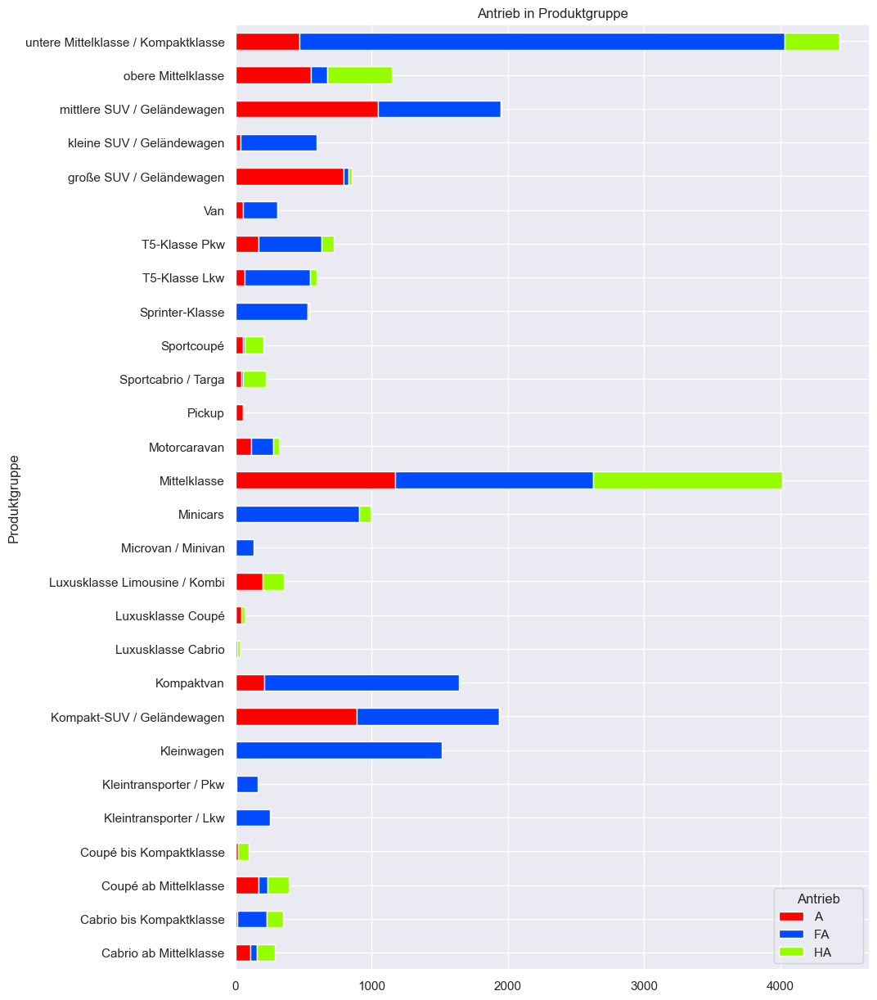

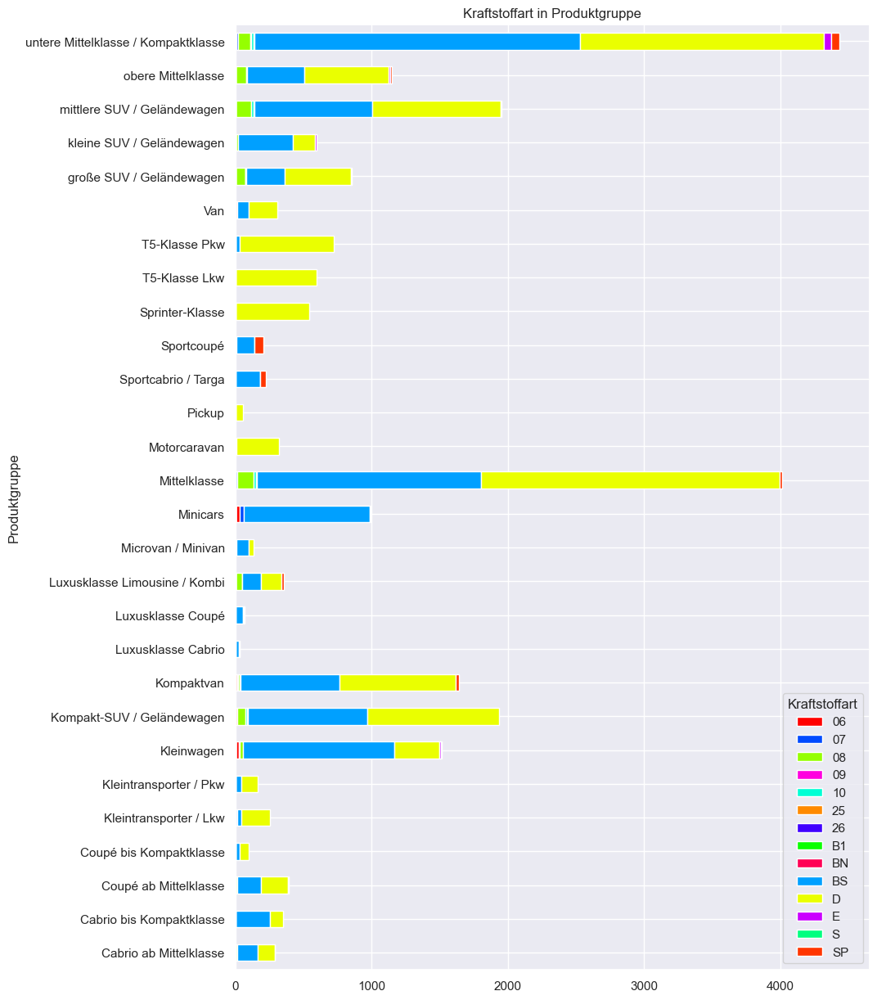

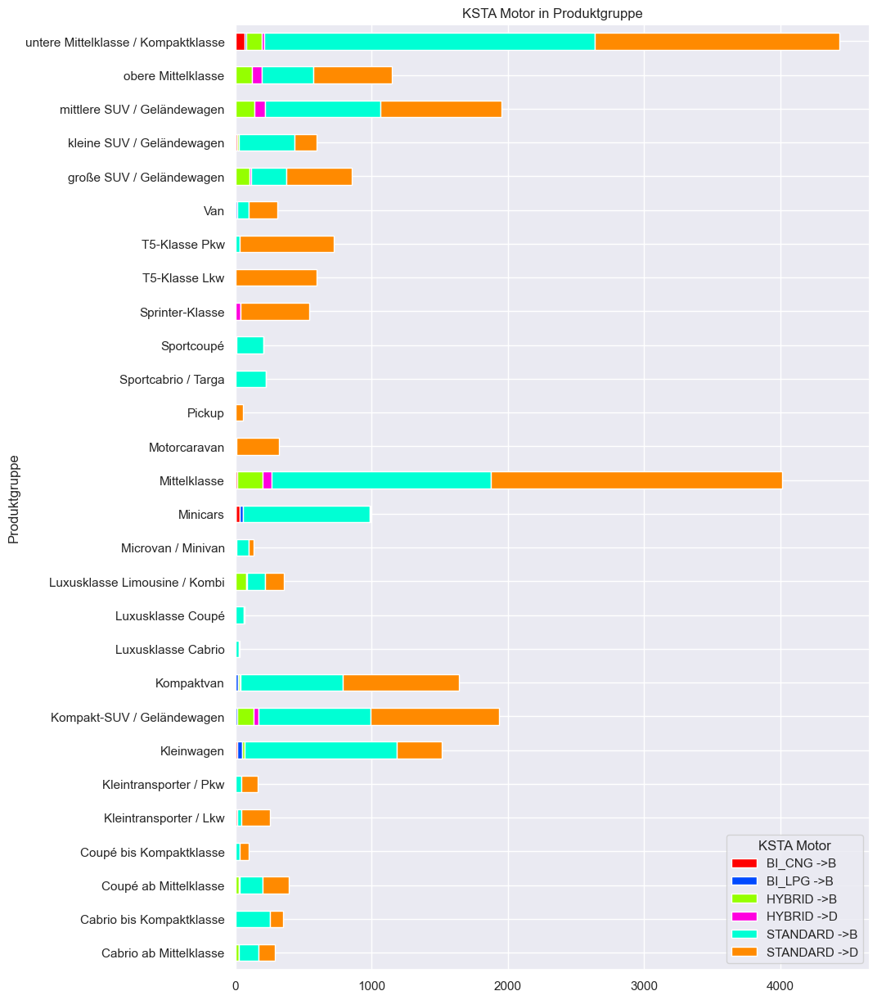

In [150]:
non_numeric_features = ["Antrieb", "Kraftstoffart", "KSTA Motor"]

from matplotlib.colors import hsv_to_rgb
from cycler import cycler

#Generiere unterschiedliche Farben, da sonst diese reused werden ab einen bestimmten Punkt
colors = [hsv_to_rgb([(i * 0.618033988749895) % 1.0, 1, 1])
          for i in range(100)]

#Gehe durch die List mit den nicht numerischen Werten durch und plotte jeweils eineProduktgruppen-spezifische Häufigkeitsverteilung
for non_numeric_feature in non_numeric_features:
    #Gruppiere die Daten nach der Produktgruppe und innerhalb der Produktgruppe nach dem jeweiligen nicht-numerischen Wert,
    #und aggregiere die Werte anhand der Spalte des jeweiligen nicht-numerischen Werts
    #Nutze unstack() DataFrame mit einer neuen Ebene von Spaltenbeschriftungen zu erstellen und fillna(0) um NaN Werte mit 0 zu füllen
    plt.rc("axes", prop_cycle=(cycler("color", colors)))
    data_grouped = data.groupby(["Produktgruppe", non_numeric_feature])[non_numeric_feature].count().unstack().fillna(0) 
    #Es ist möglich eine Größe für das Plotten der Daten mit anzugeben, je nach Größenangabe kann das Layout unübersichtlich erscheinen
    data_grouped.plot.barh(stacked=True, title=non_numeric_feature + " in Produktgruppe",)


**2. Plotten Sie für alle numerischen Merkmale jeweils einen Produktgruppen-spezifischen Boxplot in der unten dargestellten Form.**

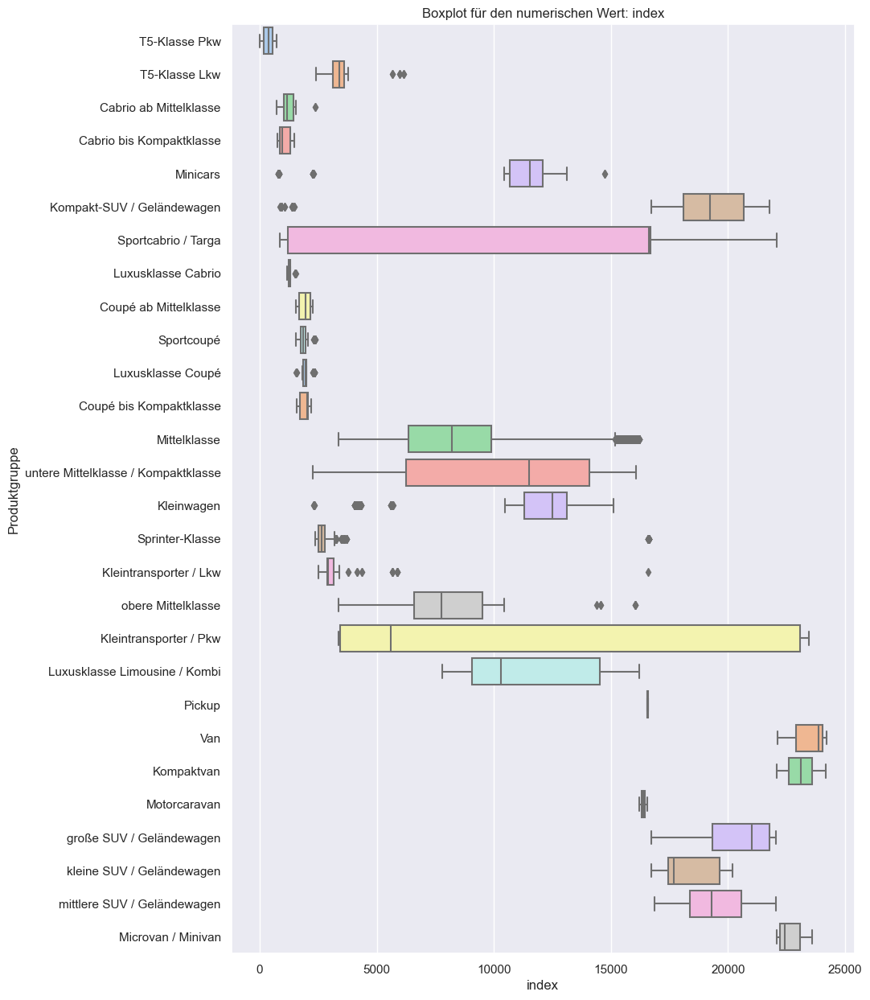

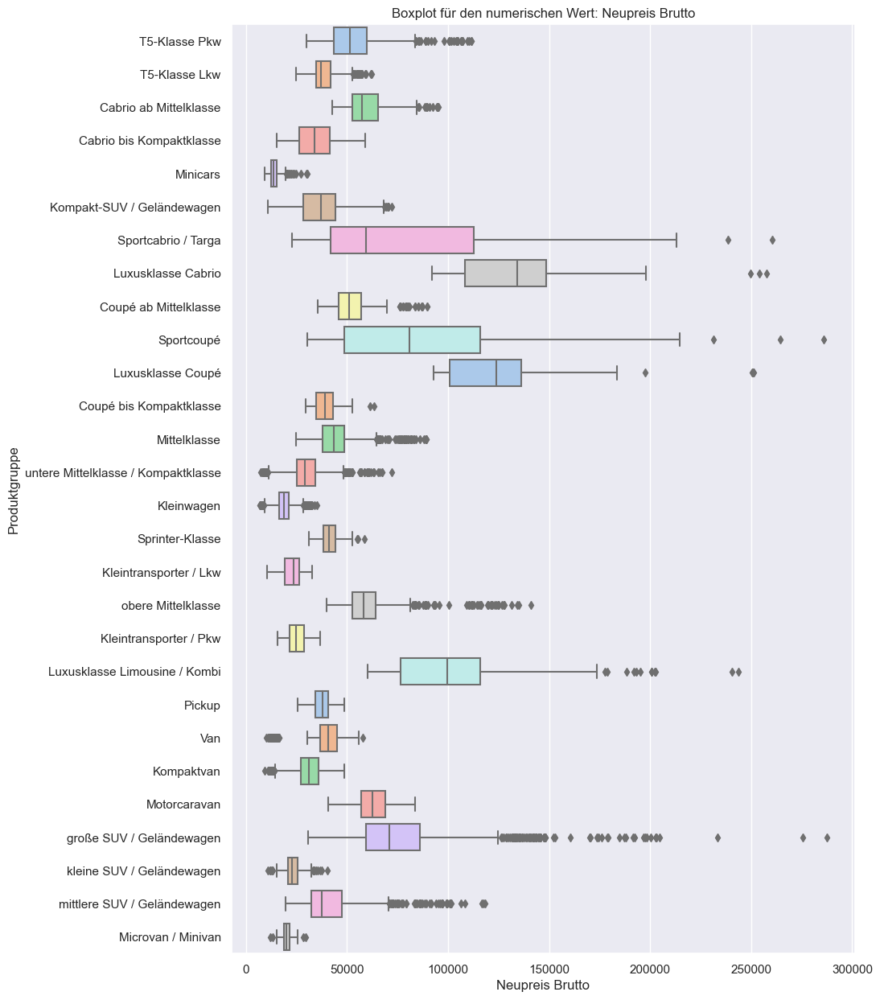

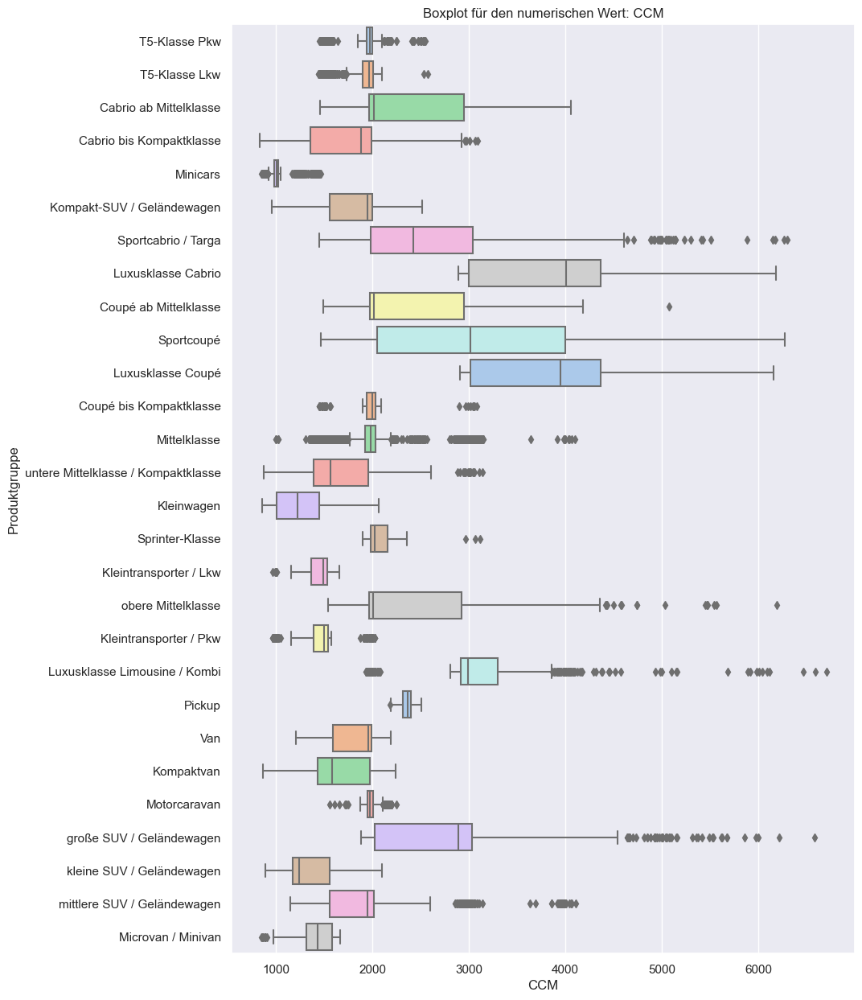

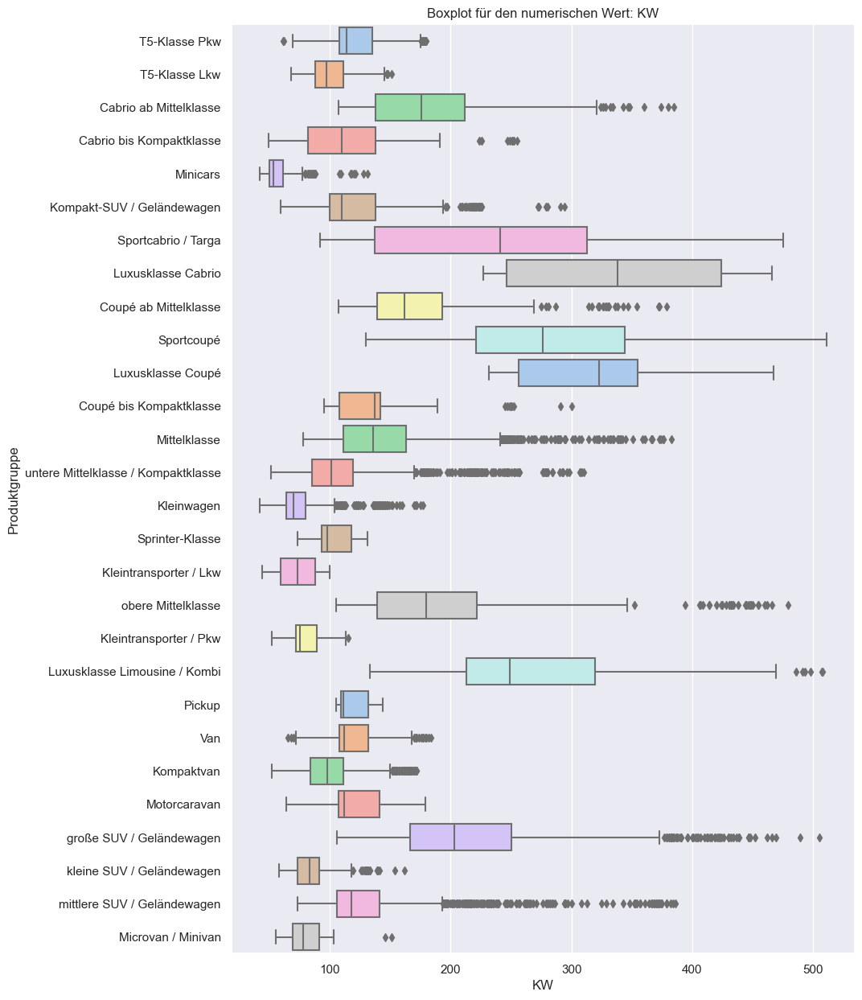

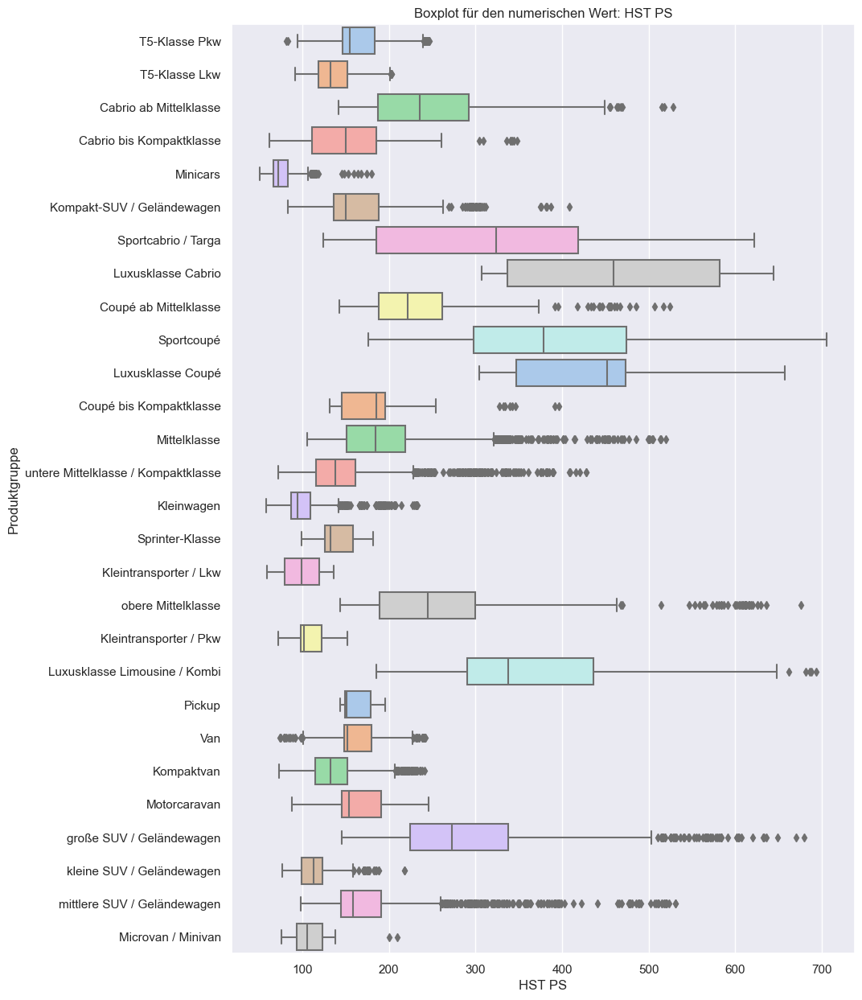

...

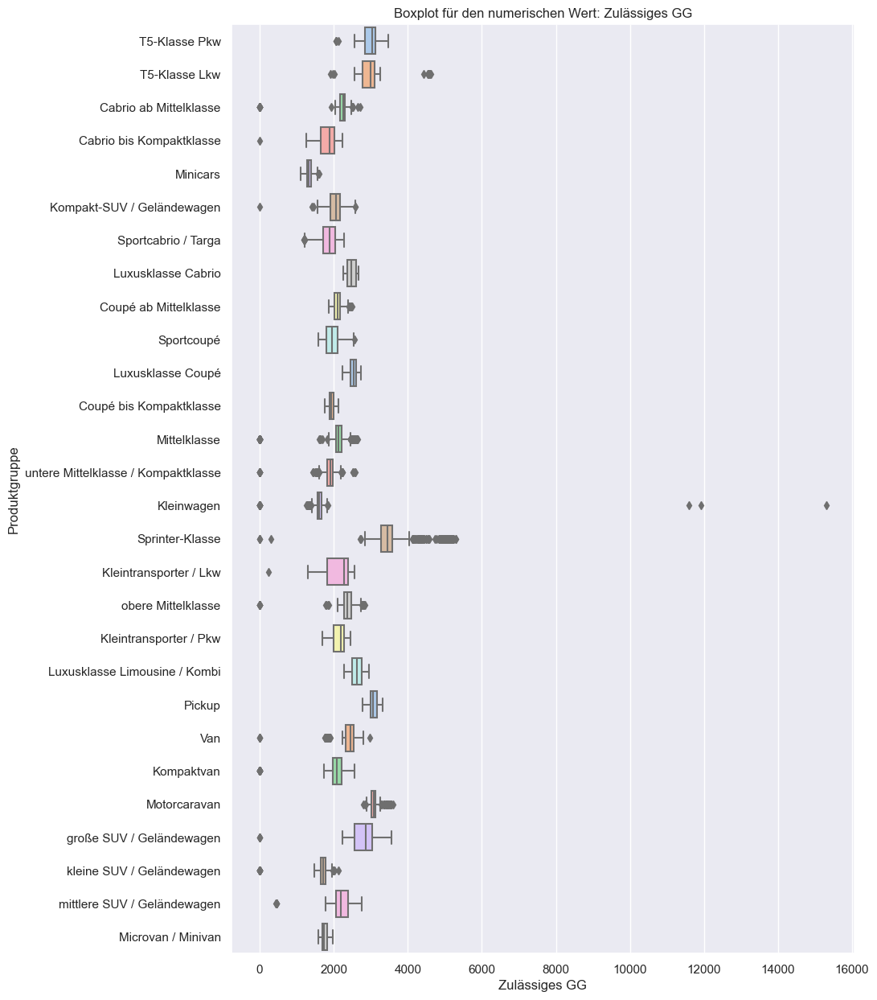

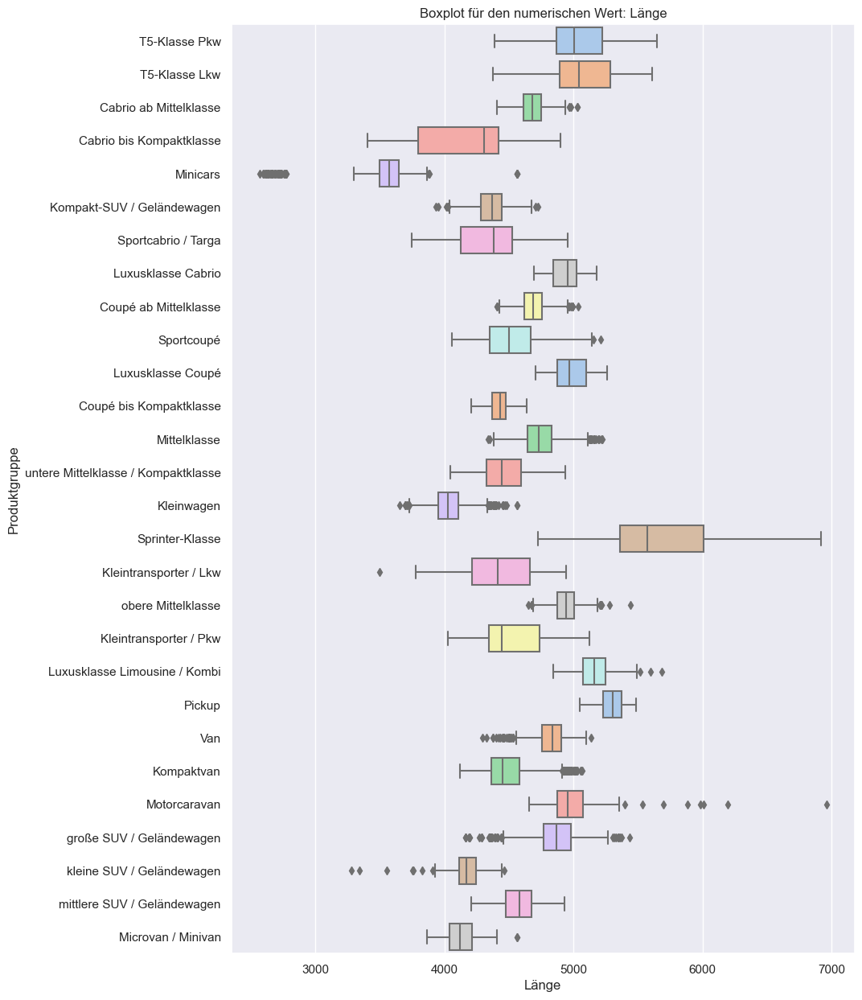

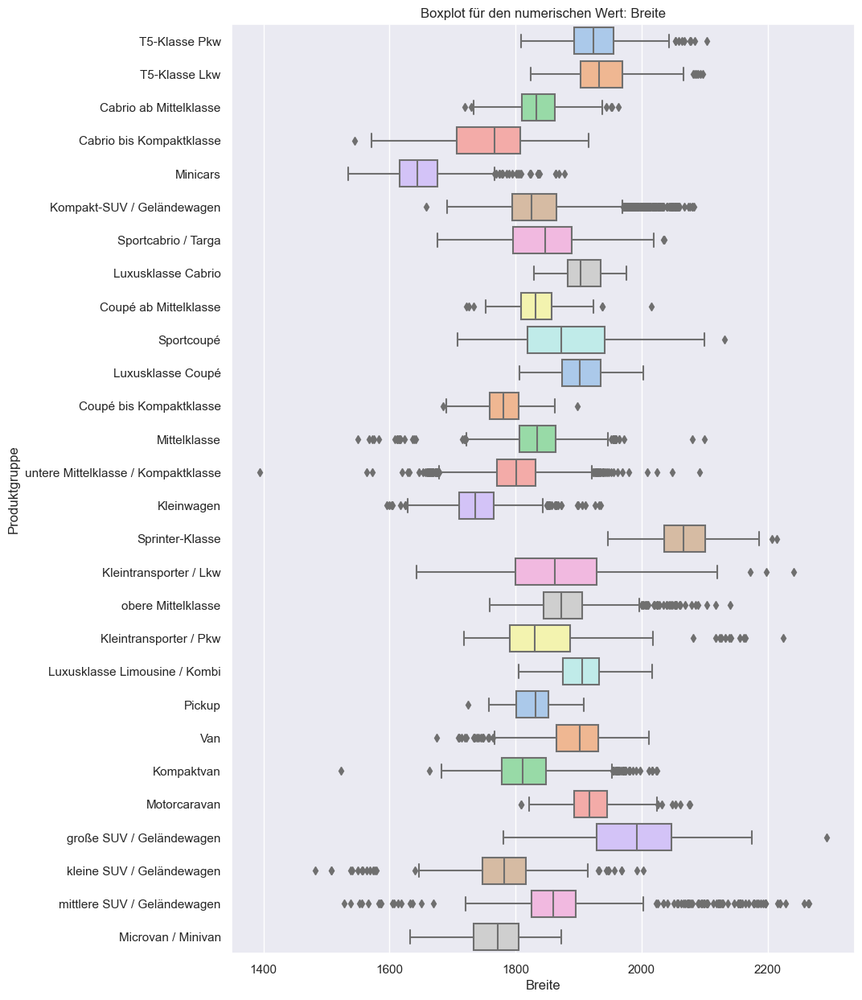

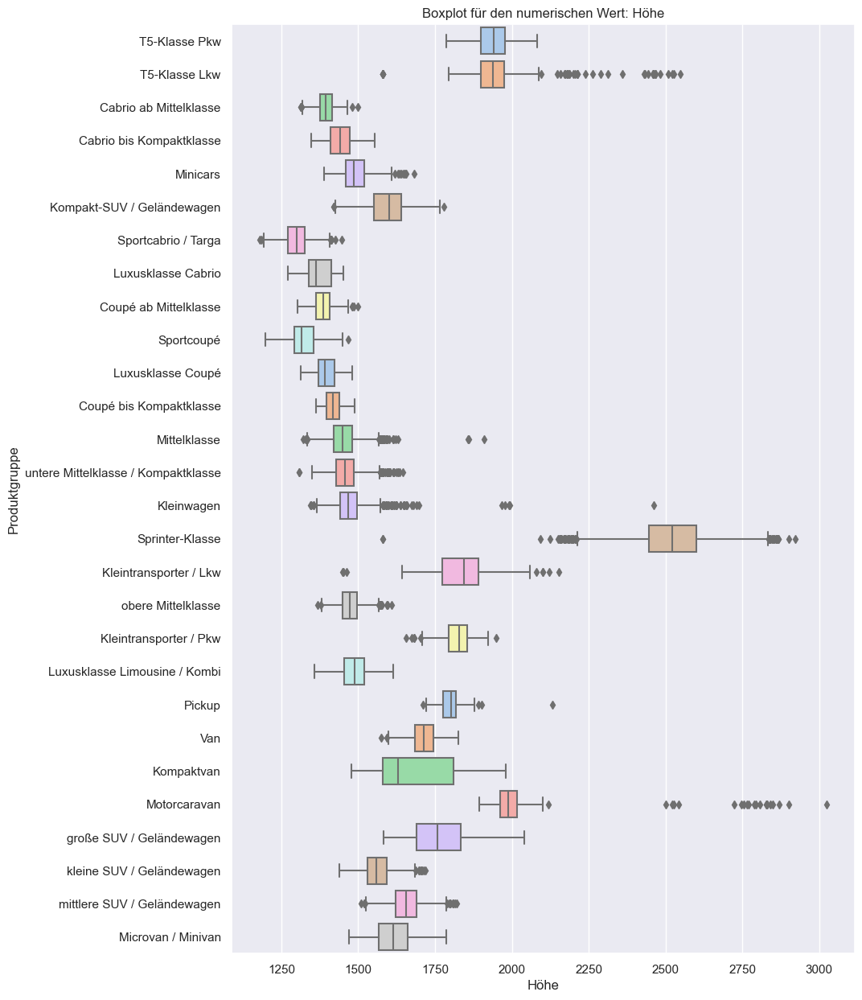

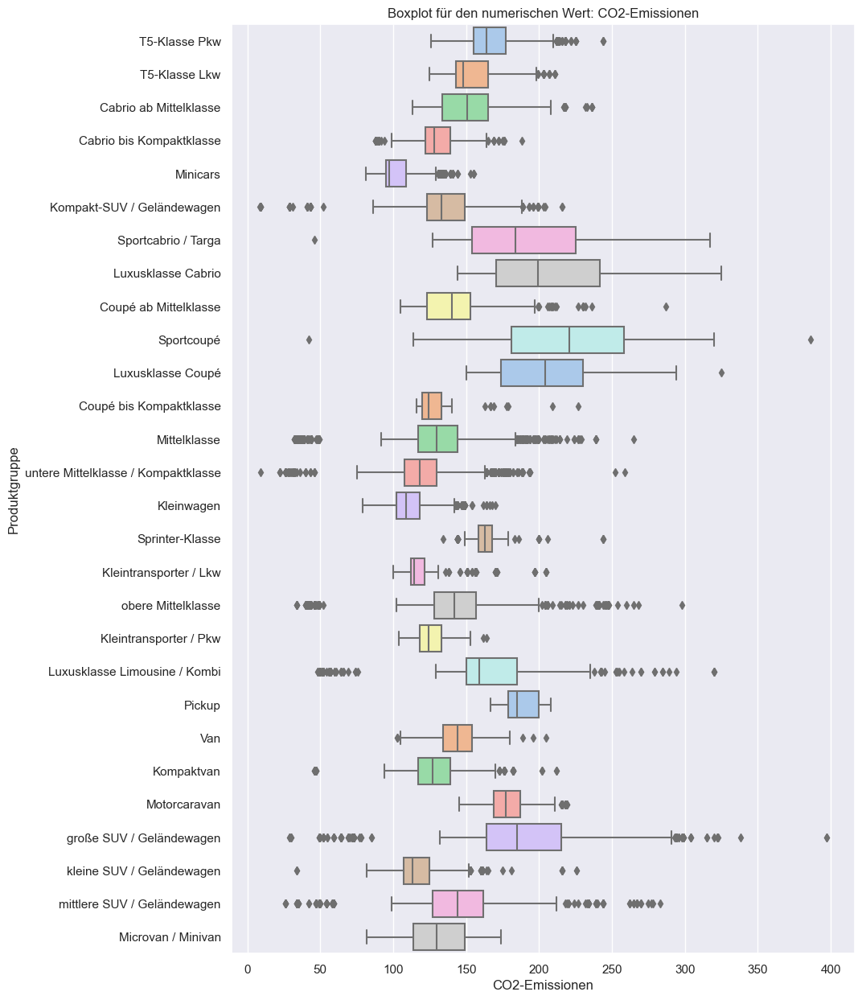

In [151]:
#Für jeden numerischen Wert einen Boxplot plotten
for numeric_feature in numeric_features:
    sns.set(rc={"figure.figsize":(10,15)})
    sns.boxplot(y=data["Produktgruppe"], x=data[numeric_feature], palette="pastel").set_title("Boxplot für den numerischen Wert: " + numeric_feature)
    plt.show()

**3. Erzeugen Sie mit plotly.express scatter() einen 2-dimensionalen Plot, in dem alle Fahrzeuge wie folgt dargestellt werden (pro Fahrzeug ein Marker):**


1. x-Achse: Länge
2. y-Achse: Höhe
3. Farbe des Markers: Produktgruppe
4. Größe des Markers: Leergewicht
5. Bei Mouse-Over soll für den jeweiligen Marker der entsprechende Wert von Neupreis Brutto und HST-HT Benennung angezeigt werden.

In [195]:
fig = px.scatter(data, 
                 x=data["Länge"], 
                 y=data["Höhe"], 
                 title="Fahrzeuge", 
                 color="Produktgruppe", 
                 size="Leergewicht", 
                 color_discrete_sequence=px.colors.qualitative.Dark24,
                 hover_name="Produktgruppe", 
                 #Zeige nur Neupreis Brutto und HST Benennung an
                 hover_data={"Höhe": False, 
                             "Länge": False,
                             "Produktgruppe": False,
                             "Leergewicht": False,
                             "Neupreis Brutto": True, 
                             "HST Benennung": True
                             })

fig.show("notebook")

### Data Encoding

1. Categoriale Merkmale ohne Ordnungsrelation (=nominale Merkmale) müssen One-Hot-Encodiert werden. Führen Sie für die drei categorialen Merkmale ein One-Hot-Encoding mit dem [scikit-learn LabelBinarizer](https://scikit-learn.org/stable/modules/generated/sklearn.preprocessing.LabelBinarizer.html) durch.
2. Fügen Sie die one-hot-encodierten Spalten mit den numerischen Spalten zusammen. Weisen Sie die entsprechende Eingabedatenmatrix einem 2-dimensionalen numpy-array `X` zu. 
3. Führen Sie auf die Zielvariable `Produktgruppe` ein Label-Encoding mit [scikit-learn LabelEncoder](https://scikit-learn.org/stable/modules/generated/sklearn.preprocessing.LabelEncoder.html#sklearn.preprocessing.LabelEncoder) aus. Weisen Sie diese Daten dem 1-dimensionalen numpy-array `y` zu.

**1. Categoriale Merkmale ohne Ordnungsrelation (=nominale Merkmale) müssen One-Hot-Encodiert werden.<br> 
Führen Sie für die drei categorialen Merkmale ein One-Hot-Encoding mit dem scikit-learn LabelBinarizer durch.**

In [198]:
#Überprüfung was für unterschiedliche Werte die jeweiligen Spalten besitzen
for non_numeric_feature in non_numeric_features:
    unique_value = data[non_numeric_feature].unique()
    count_of_value = len(data[non_numeric_feature].unique())
    print(non_numeric_feature, unique_value)
    print(non_numeric_feature, count_of_value)
    print()

#  Unique-Werte Produktgruppe
unique_Produktgruppe = data["Produktgruppe"].unique()
print("Produktgruppe:", unique_Produktgruppe)

#  Anzahl Unique-Werte Produktgruppe
count_Produktgruppe = len(data["Produktgruppe"].unique())
print("Produktgruppen-Anzahl:", count_Produktgruppe)

Antrieb ['FA        ' 'A         ' 'HA        ']
Antrieb 3

Kraftstoffart ['BS' 'D ' '08' 'SP' '06' '07' 'B1' 'E ' '25' '10' 'S ' 'BN' '09' '26']
Kraftstoffart 14

KSTA Motor ['STANDARD ->B' 'STANDARD ->D' 'HYBRID ->B' 'HYBRID ->D' 'BI_LPG ->B'
 'BI_CNG ->B']
KSTA Motor 6

Produktgruppe: ['T5-Klasse Pkw' 'T5-Klasse Lkw' 'Cabrio ab Mittelklasse'
 'Cabrio bis Kompaktklasse' 'Minicars' 'Kompakt-SUV / Geländewagen'
 'Sportcabrio / Targa' 'Luxusklasse Cabrio' 'Coupé ab Mittelklasse'
 'Sportcoupé' 'Luxusklasse Coupé' 'Coupé bis Kompaktklasse' 'Mittelklasse'
 'untere Mittelklasse / Kompaktklasse' 'Kleinwagen' 'Sprinter-Klasse'
 'Kleintransporter / Lkw' 'obere Mittelklasse' 'Kleintransporter / Pkw'
 'Luxusklasse Limousine / Kombi' 'Pickup' 'Van' 'Kompaktvan'
 'Motorcaravan' 'große SUV / Geländewagen' 'kleine SUV / Geländewagen'
 'mittlere SUV / Geländewagen' 'Microvan / Minivan']
Produktgruppen-Anzahl: 28


In [199]:
#One-Hot-Encoding für categorialen Merkmale
#Benutze LabelBinarizer für categoriale Merkmale
lb = preprocessing.LabelBinarizer()
categorial_results = []

#Gehe durch die categorialen Merkmale durch und speichere diese in eine Liste mit den korrespondierenden Namen
#um diese später anzuzeigen
for categorial_feature in non_numeric_features:
    categorial_results.append([categorial_feature, lb.fit_transform(data[categorial_feature])])
    #categorial_results.append(lb.fit_transform(data[categorial_feature]))

print(categorial_results)

[['Antrieb', array([[0, 1, 0],
       [0, 1, 0],
       [0, 1, 0],
       ...,
       [0, 1, 0],
       [0, 1, 0],
       [0, 1, 0]])], ['Kraftstoffart', array([[0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       ...,
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0]])], ['KSTA Motor', array([[0, 0, 0, 0, 1, 0],
       [0, 0, 0, 0, 1, 0],
       [0, 0, 0, 0, 1, 0],
       ...,
       [0, 0, 0, 0, 0, 1],
       [0, 0, 0, 0, 0, 1],
       [0, 0, 0, 0, 0, 1]])]]


**2. Fügen Sie die one-hot-encodierten Spalten mit den numerischen Spalten zusammen.<br>
Weisen Sie die entsprechende Eingabedatenmatrix einem 2-dimensionalen numpy-array X zu.**

In [200]:
numeric_data = data[numeric_features[1:]]

for nonNumeric in non_numeric_features:
    numeric_data = numeric_data.join(pd.DataFrame(lb.fit_transform(data[nonNumeric]),
                                                columns=lb.classes_,
                                                index=numeric_data.index))
X = numeric_data.to_numpy()

#Nachchecken ob X zweidimensional ist
#Gibt ein Tupel zurück, dass die Länge jeder Dimension enthält
display(X.shape)
#Gibt Nummer der Dimensionen des Arrays zurück
X.ndim

(24194, 35)

2

**3. Führen Sie auf die Zielvariable Produktgruppe ein Label-Encoding mit scikit-learn LabelEncoder aus. Weisen Sie diese Daten dem 1-dimensionalen numpy-array y zu.**

In [201]:
le = preprocessing.LabelEncoder()
y = le.fit_transform(data["Produktgruppe"])

#Gibt ein Tupel zurück, dass die Länge jeder Dimension enthält
display(y.shape)
#Gibt Nummer der Dimensionen des Arrays zurück
y.ndim

(24194,)

1

### Generate Training- and Testpartition
Benutzen Sie die [scikit-learn Methode train_test_split()](https://scikit-learn.org/stable/modules/generated/sklearn.model_selection.train_test_split.html) um `X` und `y` in einer Trainings- und Testpartition aufzuteilen. 30% der Daten soll für das Testen, 70% für das Training benutzt werden.

In [202]:
#Aufteilen von x und y in Trainings- und Testpartition
#test_size = 0.3 => 30% das Testen nutzen und 70% für das Training
#random_state = 2 => Eine fixe Zahl verwenden um zu vermeiden, dass die Partitionierung jedes mal unterschiedlich ist
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=2)

### Decision Tree Training, Test and Evaluation
1. Trainieren Sie einen [Entscheidungsbaum](https://scikit-learn.org/stable/modules/generated/sklearn.tree.DecisionTreeClassifier.html) mit den Trainingsdaten.
2. Wenden Sie den gelernten Entscheidungsbaum auf die Testdaten.
3. Evaluieren Sie die Qualität des Entscheidungsbaumes indem Sie 
     - einen [classification_report](https://scikit-learn.org/stable/modules/generated/sklearn.metrics.classification_report.html) erzeugen. 
     - die [confusion matrix](https://scikit-learn.org/stable/modules/generated/sklearn.metrics.plot_confusion_matrix.html) plotten.
 
 Interpretieren Sie das Ergebnis.
 
4. Führen Sie eine [10-fache Kreuzvalidierung](https://scikit-learn.org/stable/modules/generated/sklearn.model_selection.cross_val_score.html) des Entscheidungsbaumes mit den Daten `X` und `y` aus. Interpretieren Sie das Ergebnis.
5. Bestimmen Sie die *Wichtigkeit* der Eingabemerkmale für die Klassifikationsaufgabe, indem Sie auf den in 1.) gelernten DecisionTree das Attribut `feature_importance_` abfragen. Stellen Sie die Werte in einem Barplot dar.

**Was ist ein Decision Tree?**

Gerichtete und geordnete Bäume zur Entscheidungsfindung.

**Was ist eine Confusion-Matrix?**

Die Konfusions-Matrix, auch Fehlermatrix genannt, ist ein Visualiseringstool für die Evaluation eines Klassifikationsmodell. <br>
Sie stellt eine zweidimensionale Matrix dar, in welcher eine Achse für die vorhergesagten Klassen steht und die andere für die tatsächlichen Klassen.(https://www.kompetenzzentrum-usability.digital/definition/confusion-matrix, Zugriff am 31.10.22)

**Was ist ein Classification Report?**

Das Classification Report wird genutzt, um die Qualität von Vorhersagen zu bemessen.
Speziell werden hierbei die True Positives, True Negatives, False Positives und False Negatives genutzt, um die Metriken eines Classification Reports zu bemessen. (https://muthu.co/understanding-the-classification-report-in-sklearn/, Zugriff am 31.10.22)

In [203]:
from timeit import default_timer as timer
start = timer()
#1. Trainiere Entscheidungsbaum mit Trainingsdaten
#Konfigurieren des Entscheidungsbaums
clf = tree.DecisionTreeClassifier(random_state=2).fit(X_train, y_train)

#2.Nun gelernten Entscheidungsbaum auf Testdaten anwenden
#y_pred (1-Dimensionaler Array) enthält die vorhergesagten Werte, welche später mit den tatsächlichen Testdaten von y verglichen werden
y_pred = clf.predict(X_test)
# ...
end = timer()
print("Zeit zum Trainieren: ", end - start) 

Zeit zum Trainieren:  0.3321294999914244


**Zusatz - Decision Tree plotten**

Als Zusatz wird der trainierte Decision Tree geplotted.

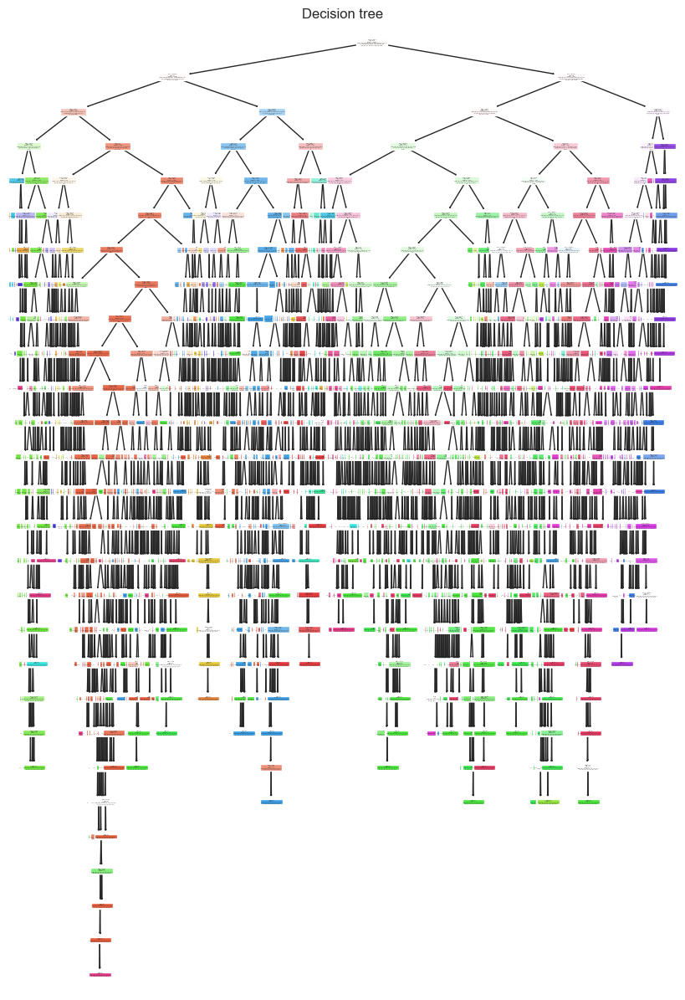

In [204]:
tree.plot_tree(clf, filled=True)
plt.title("Decision tree")
plt.show()

In [159]:
#Genauigkeit evaluieren
print("Genauigkeit: ", metrics.accuracy_score(y_test, y_pred))

#3.Evaluieren der Qualität des Entscheidungsbaums
#classification_report 
y_true = y_test
print(metrics.classification_report(y_true, y_pred, target_names=le.classes_))

Genauigkeit:  0.8261468521834964
                                     precision    recall  f1-score   support

             Cabrio ab Mittelklasse       0.83      0.86      0.85       100
           Cabrio bis Kompaktklasse       0.95      0.93      0.94        97
              Coupé ab Mittelklasse       0.83      0.83      0.83       128
            Coupé bis Kompaktklasse       0.90      0.90      0.90        29
             Kleintransporter / Lkw       0.87      0.90      0.88        79
             Kleintransporter / Pkw       0.75      0.61      0.67        54
                         Kleinwagen       0.89      0.87      0.88       465
         Kompakt-SUV / Geländewagen       0.67      0.71      0.69       564
                         Kompaktvan       0.66      0.72      0.69       472
                 Luxusklasse Cabrio       0.75      0.38      0.50         8
                  Luxusklasse Coupé       0.67      0.75      0.71        16
      Luxusklasse Limousine / Kombi       

**Evaluierung der Classification Report**

1. **Precision**<br>
Wenn man sich die Werte vom Classification Report anschaut, kann man erkennen, dass die Precision Werte durchschnittlich einen guten Wert (x > 0.5) Wert aufweisen. Aus den Werten kann entommen werden, dass die meisten Trainingsdaten, welche als richtig klassifiziert worden sind auch der in der richtigen Klassifikation liegen. Somit ist sie ein Maß für Genaugikeit und definiert, dass eine Klasse richtig ist, wenn sie vorhergesagt wird.

$$
\text{Precision} = \frac{\text{True Positive}}{\text{True Positive / False Positive}}
$$

2. **Recall**<br>
Auch die Recall Werte weisen gute Werte auf, wodurch man schlussfolgern kann, dass die True Positive Rate sehr gut ist. Zum Beispiel sind die 86% der "Cabrio ab Mittelklasse" tatsächlich auch als diese erkannt worden.

$$
\text{Recall} = \frac{\text{True Positive}}{\text{True Positive + False Negative}}
$$

3. **F1-Score**<br>
Der F-Score setzt sich aus Precision und Recall (harmonisches Mittel) zusammen und beschreibt die Gesamtgenauigkeit der Vorhersagen. Ein guter F-Score ist perfekt wenn es den Wert 1 besitzt, während 0 sehr schlecht ist. Anhand obiger Daten kristallisiert sich heraus, dass der F-Score nah an der 1 ist und somit einen guten Wert aufweist. 

$$
\text{F1-Score} = \frac{\text{2 x Precision x Recall}}{\text{Precision + Recall}}
$$

4. **Accuracy**<br>
Accuracy beschreibt die Genauigkeit bzw. Rate aller insgesamt richtigen Klassifikationen. Da dieser Wert hier um die 83% beträgt kann wieder geschlussfolgert werden, dass recht gut klassifiziert wurde.

$$
\text{Accuracy} = \frac{\text{True Positive + True Negative}}{\text{Anzahl der Datensätze}}
$$

<br>
(Aus Notizen von der Vorlesung "Künstliche Intelligenz")

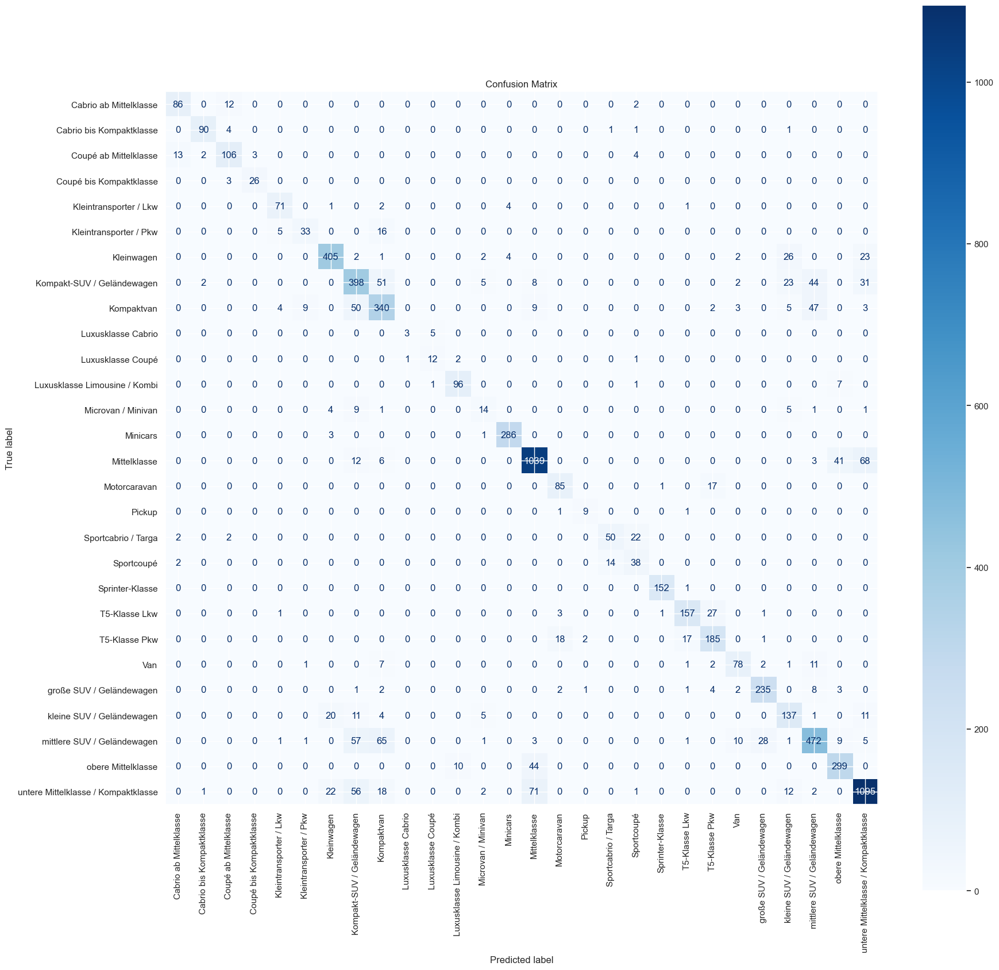

In [160]:
#Plotten der confusion matrix
fig, ax = plt.subplots(figsize=(20,20))
ax.set_title("Confusion Matrix")
metrics.ConfusionMatrixDisplay.from_estimator(clf, X_test, y_test, cmap=plt.cm.Blues, ax=ax, display_labels=le.classes_, xticks_rotation = "vertical")
plt.show()

**Evaluierung der Confusion Matrix**

Die Confusion Matrix hilft beim Evaluieren unserer Klassifikationen. Dabei erfolgt die Darstellung in einer Matrix, indem die Werte nur als richtig und falsch festgestellt werden können. In unserem Fall ob das "True Label" dem "Predicted Label" entspricht.<br>
Dabei sind die diagonalen Werte (von links oben bis rechts unten) diejenigen, bei denen die richtigen Labels der Produktgruppen zugeordnet werden. Es wird sichtbar, dass z.B. `Cabrio ab Mittelklasse` richtig zugeordnet und nicht als andere Klassen erkannt worden sind. Da eine Diagonale trotz einiger Ausreißer [1] in der Confusion Matrix sehr gut erkennbar ist, kann geschlussfolgert werden, das unser Modell gut trainert ist.<br><br>

[1]: Beispielsweise wurden 44 `mittlere SUV/Geländewagen` als `kompakt-SUV/Geländewagen`erkannt.<br>

**4. Führen Sie eine 10-fache Kreuzvalidierung des Entscheidungsbaumes mit den Daten X und y aus. Interpretieren Sie das Ergebnis.**

**Was ist Kreuzvalidierung?** 

Ist eine Modellvalidierungstechnik, um zu bewerten wie sich die Ergebnisse einer statistischen Analyse auf einen unabhängigen Datensatz verallgemeinern lassen. (https://wiki.edu.vn/wiki13/2020/12/13/kreuzvalidierung-statistik-wikipedia/, Zugriff am 31.10.22)

In [161]:
# 10-fache Kreuzvalidierung
scores = cross_val_score(clf, X, y, cv=10)

print("%0.2f Accuracy mit einer Standardabweichung von %0.2f" % (scores.mean(), scores.std()))

0.73 Accuracy mit einer Standardabweichung von 0.03


**Evaluierung der Kreuzvalidierung**

Durch den niedrigen Wert der Standardabweichung (0.3) beträgt die Genauigkeit aller richtigen Klassifikationen der Kreuzvalidierung 73%, was ein hoher Wert für die Accuracy ist.<br>
Vor allem in der Praxis werden zwischen 5 und 10 Faltungen verwendet, da dies ein optimales Gleichgewicht zwischen Verzerrung und Varianz bietet. (https://statologie.de/k-fache-kreuzvalidierung/, Zugriff am 01.11.22)<br>
Mit dem Vergleich zum vorherigen Classification Report, bei dem die Accuracy den Wert 0.82 betrug, ist der Wert diesmal um einiges geringer, weil durch die Kreuzvalidierung das Overfitting (und Underfitting) reduziert wurde. Trotz des geringeren Wertes ist das Modell nun generell besser auf unterschiedliche Testdaten trainiert als auf nur spezielle Fälle.

### 14.11.22

**Overfitting**

--> Modell zu sehr angepasst (z.B. Anwendung auf andere Testdaten erzielen schlechtes Ergebnis (zu viele neuronale Netze))<br>
--> Zu hohe Anzahl von Hidden Neuronen<br>
--> Durch zu langes Training<br>
--> Cross Validation (Kreuzvalidierung) ist ein Verfahren, um zu prüfen, wie gut die Vorhersagekraft eines statistischen Modells ist.<br>
--> Cross Validation ist eine Evaluierung und kein Modell<br>
--> Data Augmentation bevor trainieren um Overfitting entgegenzuwirken<br>
--> Wir benutzen die Trainingsdaten, um mit dem Trainingsalgorithmus das Modell zu trainieren. Je mehr Daten wir haben, desto „stärker“ wird das Modell. Hat man dem Trainingsalgorithmus alle verfügbaren Daten zur Verfügung gestellt, bezeichnet man dies als “Epoche”.

**5. Bestimmen Sie die Wichtigkeit der Eingabemerkmale für die Klassifikationsaufgabe, indem Sie auf den in 
1.) gelernten DecisionTree das Attribut feature_importance_ abfragen. Stellen Sie die Werte in einem Barplot dar.**

**Was ist Feature Importance?** 

Feature Importance bezieht sich auf Techniken, die eine Bewertung für alle Eingabefunktionen für ein bestimmtes Modell berechnen – die Bewertungen repräsentieren einfach die „Wichtigkeit“ jeder Funktion.<br>
Je höher der Score des Features, desto höher der Effekt auf das Modell, welches benutzt wird um eine Variable vorherzusagen.

<AxesSubplot:title={'center':'Feature Importances Decision Tree'}>

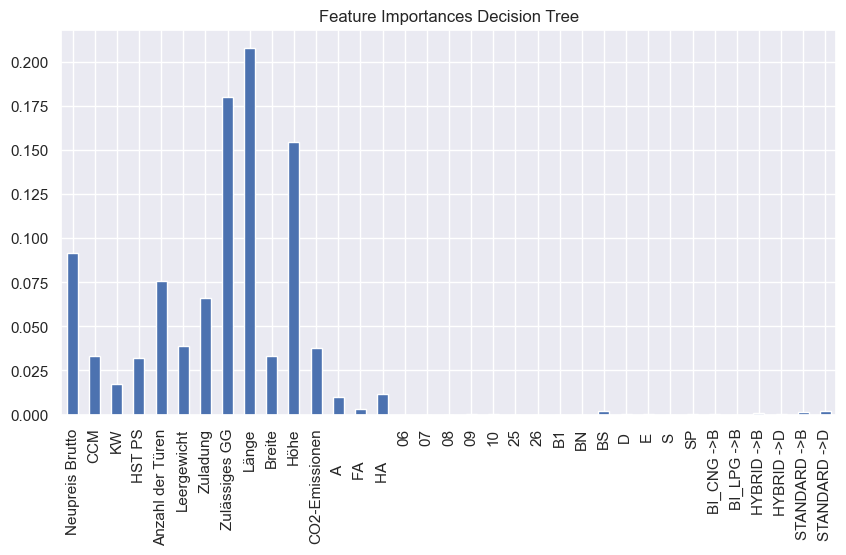

In [162]:
feature_importances = pd.Series(clf.feature_importances_ , index = numeric_data.columns)

feature_importances.plot(kind="bar", title="Feature Importances Decision Tree", figsize=(10,5))

**Evaluierung der Feature Importances** 

Anhand der oberen Grafik, welches die Feature Importances vom trainierten Decision Tree veranschaulicht, kann entnommen werden, dass `Länge`, `Zulässiges GG` und `Höhe` die Vorhersage am stärksten beeinflusst.

### Random Forest Training, Test and Evaluation
Wiederholen Sie die Teilaufgaben 1. bis 5. des Entscheidungsbaums für einen [Random Forest](https://scikit-learn.org/stable/modules/generated/sklearn.ensemble.RandomForestClassifier.html). Vergleichen Sie die Performance der beiden Verfahren.

In [163]:
from sklearn.ensemble import RandomForestClassifier
start = timer()

#1.Teilaufgabe: Training
clf_randomForest = RandomForestClassifier(random_state=2)
clf_randomForest = clf_randomForest.fit(X_train, y_train)

#2.Teilaufgabe: Wenden den gelernten Random Forest auf Testdaten an
y_pred_randomForest = clf_randomForest.predict(X_test)

end = timer()
print("Zeit zum Trainieren: ", end - start)

Zeit zum Trainieren:  4.31720900000073


In [164]:
#3.Teilaufgabe: Classification report
y_true_randomForest = y_test
y_pred_randomForest = clf_randomForest.predict(X_test)
print(metrics.classification_report(y_true_randomForest, y_pred_randomForest,target_names=le.classes_))

                                     precision    recall  f1-score   support

             Cabrio ab Mittelklasse       0.87      0.95      0.91       100
           Cabrio bis Kompaktklasse       0.98      0.98      0.98        97
              Coupé ab Mittelklasse       0.95      0.90      0.92       128
            Coupé bis Kompaktklasse       1.00      0.93      0.96        29
             Kleintransporter / Lkw       0.97      0.96      0.97        79
             Kleintransporter / Pkw       0.94      0.54      0.68        54
                         Kleinwagen       0.91      0.95      0.93       465
         Kompakt-SUV / Geländewagen       0.87      0.85      0.86       564
                         Kompaktvan       0.85      0.88      0.87       472
                 Luxusklasse Cabrio       1.00      0.25      0.40         8
                  Luxusklasse Coupé       0.68      0.81      0.74        16
      Luxusklasse Limousine / Kombi       0.95      0.95      0.95       10

**Evaluierung der Classification Report**

1. Aus den neu gewonnen Daten hat sich zum Decision Tree nicht viel geändert, weshalb die Aussagen vom vorherigen Decision Tree (Classification Report) auch hier zu treffen.

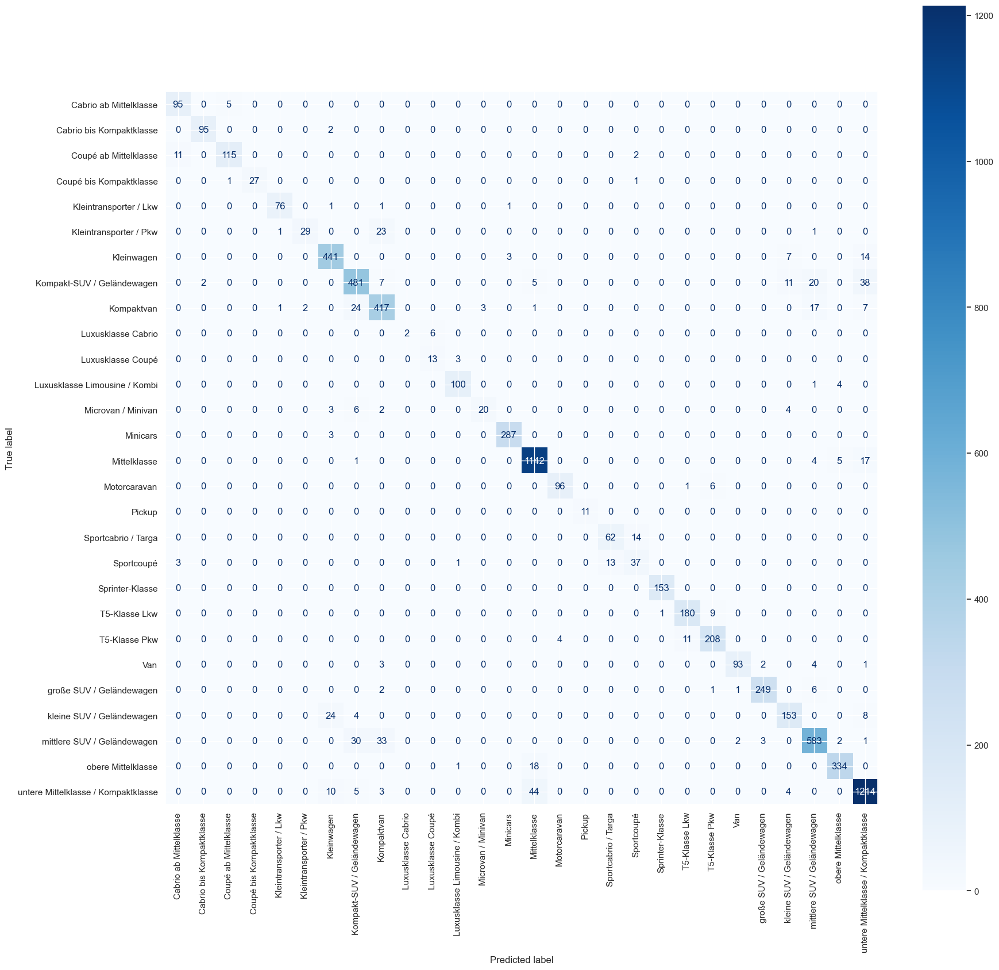

In [165]:
#3.Teilaufgabe  Confusion Matrix
fig, ax = plt.subplots(figsize=(20, 20))
metrics.ConfusionMatrixDisplay.from_estimator(clf_randomForest, X_test, y_test,cmap=plt.cm.Blues, ax=ax,display_labels = le.classes_, xticks_rotation= "vertical")

plt.show()

**Evaluierung der Confusion Matrix**

Beim Vergleich der Diagonalen mit der Confusion Matrix vom Decision Tree, kann entnommen werden, dass hier insgesamt mehr Datensätze richtig klassifiziert werden.

In [166]:
# 4. Teilaufgabe Kreuzvalidierung
scores = cross_val_score(clf_randomForest, X, y, cv=10)
print("%0.2f Accuracy mit einer Standardabweichung von %0.2f" % (scores.mean(), scores.std()))

0.78 Accuracy mit einer Standardabweichung von 0.03


**Evaluierung der Kreuzvalidierung**

Wie bei der Evaluierung der Kreuzvalidierung beim Decision Tree, hat sich die `accuracy` auch beim Random Forest im Vergleich zum Classification Report reduziert. Der Wert beträgt nach der Kreuvalidierung nun 0.78 statt 0.92, wodurch wieder davon ausgegangen werden kann, dass das Overfitting durch die 10-fache Kreuzvalidierung reduziert wurde.

**Vergleich der beiden Verfahren** 

Im Vergleich zum einzelnen Decision Tree, wird bei einem Random Forest weitere zufällige Entscheidungsbäume genutzt, bei dem jeder "Experte" verschiedene Merkmale bekommt um die Ausgabe berechnen zu können.
Letztendlich kombiniert der Random Forest die verschiedenen Ausgaben der einzelnen Entscheidungsbäume, um die endgültige Vorhersage auszugeben. Durch diesen Vorgang ist der Random Forest stabiler und zuverlässiger sein.

Beim Decision Tree betrug die Accuracy 0.82 im Classification Report, während beim Random Forest dieser Wert 0.92 beträgt.So wurden beim Decision Tree ca. 5952 und bei Random Forest ca. 6678 von insgesamt 7259 Datensätzen richtig klassifiziert. Durch den Vergleich beider Werte kann gezeigt werden, dass der Random Forest bessere Werte liefert als der Decicion Tree und somit die Klassifizierung erfolgreicer ist.

Die Zeit für die Ausführung des Random Forests (ca. 5 sek) ist in dem Falle auch natürlich höher als bei einem einzelnen Decision Tree (ca. 0.3 sek).

## Machine Learning 2: Schätzung der CO2-Emission
In diesem Teilversuch soll aus den Eingabemerkmalen 

`"CCM","HST PS", "Anzahl der Türen", "Leergewicht", "Zuladung", "Länge", "Breite", "Höhe"`

die Zielvariable 

`CO2-Emissionen`

geschätzt werden. Hierzu soll ein möglichst gutes Regressionsmodell trainiert werden.

### Visuelle Korrelationsanalyse
1. Stellen Sie für jedes der 8 Eingabemerkmale die Korrelation mit der Zielvariablen visuell in einem Scatterplot dar, in dem das jeweilige Eingabemerkmal auf der x-Achse und die Zielvariable auf der y-Achse aufgetragen wird.
2. Diskutieren Sie die Korrelationen. Welche Merkmale korrelieren am stärksten mit der Zielvariable? Erscheint Ihnen das plausibel?

## Korrelation - CO2-Emissionen und CCM

Die Korrelation zwischen den C02-Emissionen und CCM ist besonders stark zu erkennnen, da der Plot stark linear nach rechts oben verläuft. Es ergibt auch Sinn, da CCM für Hubraum steht und die Leistung steigt bei größerem Hubraum. Die steigende Leistung sorgt wiederum für eine größere C02-Emission.

0.6563754317109375


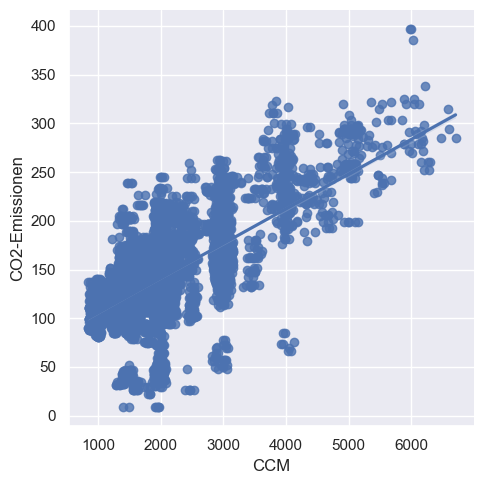

In [167]:
#CCM
fig = px.scatter(data, x="CCM", y="CO2-Emissionen")
fig1 = sns.lmplot(data=data, x="CCM", y="CO2-Emissionen")
print(data["CCM"].corr(data["CO2-Emissionen"]))
fig.show()

## Korrelation - CO2-Emissionen und HST PS

Wie im Beispiel davor sind auch hier die CO2-Emission und die PS stark voneinander abhängig. Das wird auch wieder durch den linearen Verlauf nach rechts oben sichtbar. Jedoch sind auch immer paar Ausreißer zu erkennnen. Jedoch könnte sich hierbei um E-Autos handeln.

0.599156892512846


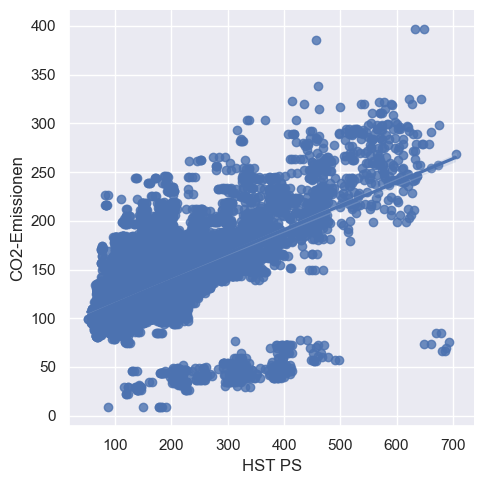

In [168]:
#HST PS 
fig = px.scatter(data, x="HST PS", y="CO2-Emissionen")
fig1 = sns.lmplot(data=data, x="HST PS", y="CO2-Emissionen")
print(data["HST PS"].corr(data["CO2-Emissionen"]))
fig.show()

## Korrelation - CO2-Emissionen und Anzahl der Türen

Die Anzahl der Türen und die CO2-Emission weisen eine extrem gering negative Korrelation auf. Aufgrund dieser negativen Korrelation kann man schlussfolgern, dass desto mehr Türen desto geringer die CO2-Emission. Da der Zusammhang so gering ist und aus gesundem Menschenverstand das keinen Sinn macht, kann man diesen Zusammenhang unter den Tisch fallen lassen bzw. es besteht im Grunde kein Zusammenhang.<br> 
**Fun Fact:** Allerdings könnte man bei der Produktion einen höheren CO2-Emission feststellen, wenn die Daten vorhanden wären. :-)

-0.1743645149552909


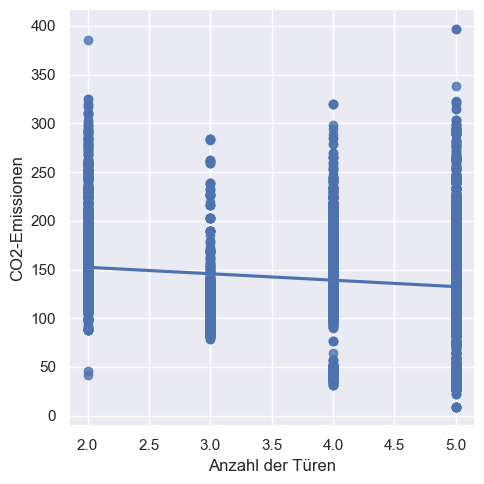

In [169]:
#Anzahl der Türen
fig = px.scatter(data, x="Anzahl der Türen", y="CO2-Emissionen")
fig1 = sns.lmplot(data=data, x="Anzahl der Türen", y="CO2-Emissionen")
print(data["Anzahl der Türen"].corr(data["CO2-Emissionen"]))
fig.show()

## Korrelation - CO2-Emissionen und Leergwicht

Je höher das Leergewicht desto schwerer das Auto. Dadurch hat ein Auto, welches schwerer ist einen höheren Verbrauch und die CO2-Emission steigt. 

0.5168151566687935


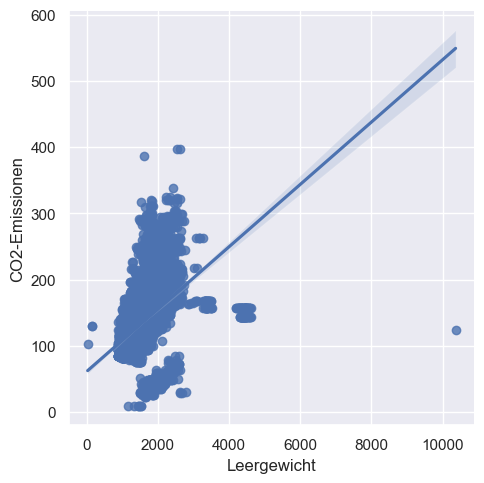

In [170]:
#Leergewicht
fig = px.scatter(data, x="Leergewicht", y="CO2-Emissionen")
fig1 = sns.lmplot(data=data, x="Leergewicht", y="CO2-Emissionen")
print(data["Leergewicht"].corr(data["CO2-Emissionen"]))
fig.show()

## Korrelation - CO2-Emissionen und Zuladung

Positive geringe Korrelation, die Zuladung beinflusst den CO2 Ausstoß kaum.

0.2337616972001408


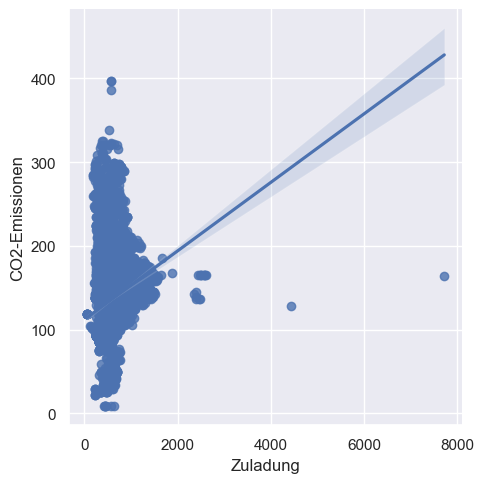

In [171]:
#Zuladung 
fig = px.scatter(data, x="Zuladung", y="CO2-Emissionen")
fig1 = sns.lmplot(data=data, x="Zuladung", y="CO2-Emissionen")
print(data["Zuladung"].corr(data["CO2-Emissionen"]))
fig.show()

## Korrelation - CO2-Emissionen und Höhe

Positive sehr geringe Korrelation, die Höhe hat kaum etwas mit dem Ausstoß von CO2 zu tun.

0.2857428200718641


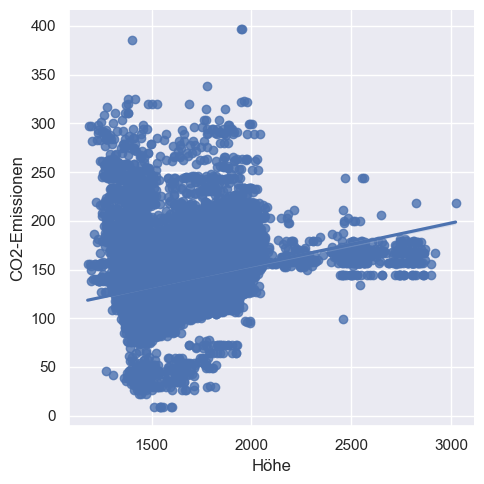

In [172]:
#Höhe
fig = px.scatter(data, x="Höhe", y="CO2-Emissionen")
fig1 = sns.lmplot(data=data, x="Höhe", y="CO2-Emissionen")
print(data["Höhe"].corr(data["CO2-Emissionen"]))
fig.show()

## Korrelation - CO2-Emissionen und Länge

Positive Korrelation, 0.414210297692714 mäßiger linearer Zusammenhang. Man könnte sagen: Je länger das Auto um so mehr CO2 wird ausgestoßen.

0.4142102976927141


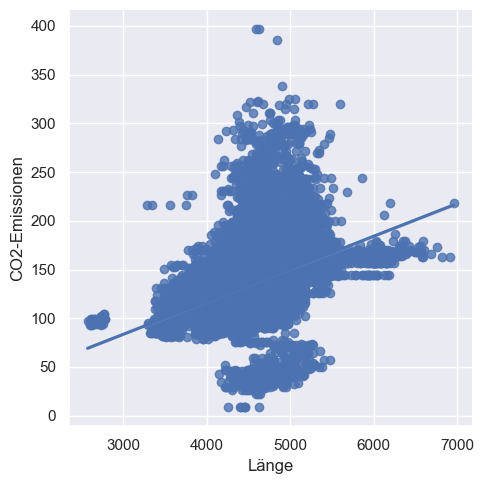

In [194]:
#Länge
fig = px.scatter(data, x="Länge", y="CO2-Emissionen")
fig1 = sns.lmplot(data=data, x="Länge", y="CO2-Emissionen")
print(data["Länge"].corr(data["CO2-Emissionen"]))
fig.show()

## Korrelation - CO2-Emissionen und Breite

Positive Korrelation, 0.4327762225723523 mäßiger linearer Zusammenhang. Man könnte sagen: Je breiter das Auto um so mehr CO2 wird ausgestoßen.

0.43277622257235304


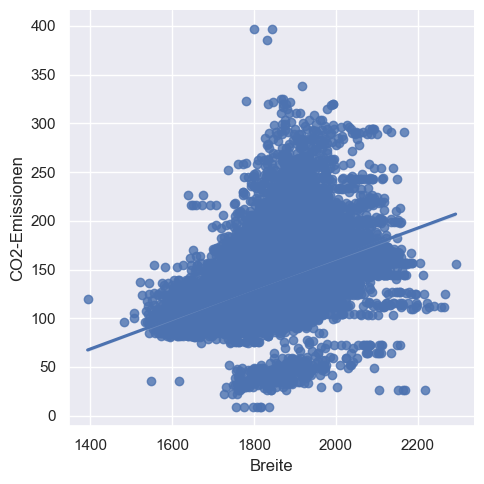

In [174]:
#Breite
fig = px.scatter(data, x="Breite", y="CO2-Emissionen")
fig1 = sns.lmplot(data=data, x="Breite", y="CO2-Emissionen")
print(data["Breite"].corr(data["CO2-Emissionen"]))
fig.show()

**Jetzt aufgedeckt: Ominöse Verschwörungstheorien**

**Unsere Theorie:** Umso breiter und höher ein Fahrzeug ist, desto mehr Luftwiderstand hat es und schlussfolglich mehr CO2-Verbrauch. Die Länge sollte dabei nicht stark ins Gewicht fallen.

**DIE TATSACHE:** Was jedoch rauskam ist das die Länge und Breite komplett ins Gewicht fallen und die Höhe kaum in Korrelation mit dem CO2-Emissionen steht.

### Data Encoding
1. Weisen Sie die Matrix der Eingabedaten dem 2-dimensionalen Array `X` und die Zielvariable dem 1-dimensionalen Array `y` zu.
2. Führen Sie auf `X` und `y` eine Partitionierung in Trainings- und Testdaten durch, wieder im Verhältnis 70/30.
3. Skalieren Sie die Eingabevariablen und die Zielvariable mit dem [MinMaxScaler](https://scikit-learn.org/stable/modules/generated/sklearn.preprocessing.MinMaxScaler.html). Die Skalierung muss sowohl auf Trainings- als auch auf Testdaten ausgeführt werden. Warum darf die Skalierung erst nach dem Split in die beiden Partitionen ausgeführt werden? Worauf ist zu achten? 

**1. Weisen Sie die Matrix der Eingabedaten dem 2-dimensionalen Array X und die Zielvariable dem 1-dimensionalen Array y zu.**

In [175]:
#Daten zuweisen: "CCM","HST PS", "Anzahl der Türen", "Leergewicht", "Zuladung", "Höhe", "Länge", "Breite"
#Nutzen hier doppelt: [[]] um auf das tatsächliche Objekt mit den jeweiligen Daten zu kommen und nicht an die Daten selbst
correlation_data = data[["CCM","HST PS","Anzahl der Türen",
 "Leergewicht","Zuladung","Höhe", "Länge","Breite"]]

#Eingabedaten zuweise
X = correlation_data.to_numpy()

#Zielvariable zuweisen
y = data[["CO2-Emissionen"]].to_numpy()
#Gibt ein zusammenhängendes abgeflachtes Array (1D-Array) mit allen Eingabe-Array-Elementen und mit demselben 
#Typ wie es zurück
y = y.ravel()
display(y)

array([218., 218., 218., ..., 153., 153., 162.])

**2. Führen Sie auf X und y eine Partitionierung in Trainings- und Testdaten durch, wieder im Verhältnis 70/30.**

In [176]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=2)

In [2]:
scaler = preprocessing.MinMaxScaler().fit(X_train)

#Trainingsdaten
X_train_scaled = scaler.transform(X_train)
X_train_scaled
len(X_train_scaled)

#fit_transform --> schaut Werte an und passt das an
#transform vorhergesagten Werte angepasst
#Skalen sind unterschiedlich
# https://www.analyticsvidhya.com/blog/2021/04/difference-between-fit-transform-fit_transform-methods-in-scikit-learn-with-python-code/

NameError: name 'preprocessing' is not defined

The fit(data) method is used to compute the mean and std dev for a given feature to be used further for scaling. The transform(data) method is used to perform scaling using mean and std dev calculated using the . fit() method. The fit_transform() method does both fits and transform.

In [178]:
#Testdaten
X_test_scaled = scaler.transform(X_test)
X_test_scaled

array([[0.1252766 , 0.27370031, 1.        , ..., 0.25013565, 0.46077982,
        0.49407115],
       [0.02570213, 0.10703364, 1.        , ..., 0.1611503 , 0.32178899,
        0.40974967],
       [0.1972766 , 0.29816514, 0.        , ..., 0.14215952, 0.41582569,
        0.35968379],
       ...,
       [0.11931915, 0.19266055, 1.        , ..., 0.22409116, 0.35917431,
        0.36231884],
       [0.16170213, 0.12844037, 0.66666667, ..., 0.39880629, 0.53440367,
        0.57971014],
       [0.2013617 , 0.20489297, 1.        , ..., 0.2116115 , 0.41009174,
        0.3715415 ]])

In [179]:
y_train = y_train.reshape(-1, 1)
scaler = preprocessing.MinMaxScaler().fit(y_train)
y_train.shape

(16935, 1)

In [180]:
y_train_scaled = scaler.transform(y_train)
y_train_scaled

array([[0.33505155],
       [0.29639175],
       [0.27319588],
       ...,
       [0.35824742],
       [0.40979381],
       [0.25773196]])

In [181]:
y_test = y_test.reshape(-1,1)
y_test_scaled = scaler.transform(y_test)
y_test_scaled

array([[0.29896907],
       [0.29639175],
       [0.31443299],
       ...,
       [0.37113402],
       [0.41752577],
       [0.31443299]])

In [182]:
y_test = y_test.reshape(-1,1)
y_test_scaled = scaler.transform(y_test)
y_test_scaled

array([[0.29896907],
       [0.29639175],
       [0.31443299],
       ...,
       [0.37113402],
       [0.41752577],
       [0.31443299]])

**3. Warum darf die Skalierung erst nach dem Split in die beiden Partitionen ausgeführt werden? Worauf ist zu achten?** 

Da Daten oft nicht die gleiche Skala besitzen und deren Werte unterschiedlich sind, würde es zu Schwierigkeiten bei der Modellierung kommen. Die Skalierung muss nach den Split passieren, da das Modell unbekannte Daten verwenden wird. Würde man das die Daten auch schon vor dem Split skalieren, könnte dies zu einer verfälschten Vorhersage führen, da die Daten nicht normalisiert sind und nicht auf einer einheitlichen Skala transformiert worden sind.

### Training, Test und Evaluation verschiedener Regressionsmodelle

Führen Sie die folgenden Teilaufgaben sowohl für ein [Single Layer Perceptron](https://scikit-learn.org/stable/modules/generated/sklearn.linear_model.SGDRegressor.html) als auch für ein [Multi Layer Perceptron](https://scikit-learn.org/stable/modules/generated/sklearn.neural_network.MLPRegressor.html) mit 20 Neuronen in der Hidden-Schicht durch. Vergleichen Sie am Ende die Performance der beiden Verfahren.
1. Trainieren Sie den Algorithmus mit den Trainingsdaten.
2. Wenden Sie das gelernte Modell auf die Testdaten an.
3. Evaluieren Sie die Qualität der Modelle, indem Sie auf die vorhergesagten Ausgaben und die wahren Ausgaben die unten gegebene Funktion aufrufen.
4. Beschreiben Sie kurz die in der Funktion verwendeten Metriken

In [183]:
from sklearn.metrics import mean_squared_error, mean_absolute_error, median_absolute_error, r2_score

In [184]:
def determineRegressionMetrics(y_test,y_pred,title=""):
    mse = mean_squared_error(y_test, y_pred)
    mad = mean_absolute_error(y_test, y_pred)
    rmsle=np.sqrt(mean_squared_error(np.log(y_test+1),np.log(y_pred+1)))# +1 for avoiding log(0) 
    r2=r2_score(y_test, y_pred)
    med=median_absolute_error(y_test, y_pred)
    print(title)
    print("Mean absolute error =", round(mad, 2))
    print("Mean squared error =", round(mse, 2))
    print("Median absolute error =", round(med, 2))
    print("R2 score =", round(r2, 2))
    print("Root Mean Squared Logarithmic Error =",rmsle)

**1. Trainieren Sie den Algorithmus mit den Trainingsdaten.**

In [185]:
# SLP 
from sklearn.linear_model import SGDRegressor
from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import Pipeline

reg = make_pipeline(preprocessing.MinMaxScaler(),
                    SGDRegressor(random_state=2))

reg.fit(X_train, y_train.ravel())
Pipeline(steps=[("minMaxSclarer", preprocessing.MinMaxScaler()),
               ("sgdregressor", SGDRegressor())])

Pipeline(steps=[('minMaxSclarer', MinMaxScaler()),
                ('sgdregressor', SGDRegressor())])

**2. Wenden Sie das gelernte Modell auf die Testdaten an.**

In [186]:
#SLP
y_pred = reg.predict(X_test)

print(reg.predict(X_test))
reg.score(X_test, y_test)

[140.46215266 108.29319744 147.5079768  ... 131.09323737 146.80910122
 139.49480587]


0.5351307066212594

In [187]:
#SLP 3. Evaluieren der Qualität
determineRegressionMetrics(y_test_scaled, y_pred, "SLP" )

SLP
Mean absolute error = 135.77
Mean squared error = 19000.15
Median absolute error = 132.72
R2 score = -2565546.75
Root Mean Squared Logarithmic Error = 4.627234687585908


In [188]:
#MLP
from sklearn.neural_network import MLPRegressor
from sklearn.datasets import make_regression

regr = MLPRegressor(hidden_layer_sizes=20, random_state=2).fit(X_train_scaled, y_train_scaled.ravel())

In [189]:
#MLP
y_pred = regr.predict(X_test_scaled)
print(y_pred)

[0.34888077 0.25519183 0.37574934 ... 0.33094001 0.37242917 0.3491543 ]


In [190]:
#MLP 3. Evaluieren der Qualität
determineRegressionMetrics(y_test_scaled, y_pred, "MLP")

MLP
Mean absolute error = 0.04
Mean squared error = 0.0
Median absolute error = 0.03
R2 score = 0.57
Root Mean Squared Logarithmic Error = 0.04281096536670922


Sieht man sich die Werte von SLP und MLP an, wird erkannt, dass SLP überall einen höheren Wert hat als MLP. 
- **Mean absolute error:** Je näher der Wert an 0 ist, desto genauer ist das Modell
- **Mean squared error:** Je näher der Wert an 0 ist, desto genauer ist das Modell
- **Median absolute error:** Je näher der Wert an 0 ist, desto genauer ist das Modell
- **R2 score:** Es kommt auf den use case an, aber näher an 1 bedeutet das er besser ist
- **Root Mean Squared Logarithmic Error:** Auch hier spiegelt ein Wert in der Nähe von 0 ein gutes Modell wieder

Insgesamt kann gesagt werden, dass das Regressionsmodell von MLP gegenüber dem SLP überlegen ist.

(https://stephenallwright.com/, Zugriff am 02.11.22)

**4. Beschreiben Sie kurz die in der Funktion verwendeten Metriken** 

- **Mean absolute error:**  Der mittlere absolute Fehler ist eine Größe der Statistik, mit deren Hilfe die Genauigkeit von Vorhersagen bestimmt werden kann. (https://de.wikipedia.org/wiki/Mittlerer_absoluter_Fehler, Zugriff am 03.11.22)

$$MAE  = (\frac{1}{n})\sum_{i=1}^{n}(y_{i} - \hat{y_{i}})$$

- **Mean squared error:**  Die mittlere quadratische Abweichung, auch erwartete quadratische Abweichung, oder mittlerer quadratischer Fehler genannt, ist ein Begriff der mathematischen Statistik. Sie gibt in der Schätztheorie an, wie sehr ein Punktschätzer um den zu schätzenden Wert streut. Damit ist sie ein zentrales Qualitätskriterium für Schätzer. In der Regressionsanalyse wird sie interpretiert als erwarteter quadratischer Abstand, den ein Schätzer vom wahren Wert hat. (https://de.wikipedia.org/wiki/Mittlere_quadratische_Abweichung, Zugriff am 03.11.22)

$$MSE = (\frac{1}{n})\sum_{i=1}^{n}(y_{i} - \hat{y_{i}})^{2}$$

- **Median absolute error:** Die mittlere absolute Abweichung vom Median ist ein robustes Streuungsmaß in der deskriptiven Statistik und gibt an, wie weit eine Stichprobe „im Mittel“ vom Median abweicht. Je nach Definition wird entweder das arithmetische Mittel oder der Median der absoluten Abweichungen berechnet. (https://de.wikipedia.org/wiki/Mittlere_absolute_Abweichung_vom_Median, Zugriff am 03.11.22)

$$MedianAE  = (\frac{1}{n})\sum_{i=1}^{n}(y_{i} - y_{median})$$

- **R2 score:** Das Bestimmtheitsmaß, auch Determinationskoeffizient, bezeichnet mit R2, ist in der Statistik eine Kennzahl zur Beurteilung der Anpassungsgüte einer Regression – beispielsweise, um zu bewerten, wie gut Messwerte zu einem Modell passen. Das Bestimmtheitsmaß beruht auf der Quadratsummenzerlegung, bei der die totale Quadratsumme in die (durch das Regressionsmodell) erklärte Quadratsumme und in die Residuenquadratsumme zerlegt wird.(https://de.wikipedia.org/wiki/Bestimmtheitsma%C3%9F, Zugriff am 03.11.22)

$$R2  = \frac{Aufgeklärte \  Varianz \   der \   abhängigen \   Variable}{Gesamtvarianz \   der \   abhängigen \   Variable}$$

- **Root Mean Squared Logarithmic Error:** Es ist eine Erweiterung des mittleren quadratischen Fehlers (MSE), die hauptsächlich verwendet wird, wenn Vorhersagen große Abweichungen aufweisen. Dabei können die Werte von 0 bis zu Millionen reichen, weshalb wir Abweichungen nicht so stark gewichten wollen bei bei MSE. (https://www.kaggle.com/code/carlolepelaars/understanding-the-metric-rmsle/notebook, Zugriff am 03.11.22)

$$RMSLE  = \sqrt{(\frac{1}{n})\sum_{i=1}^{n}(\log_{} (y_{i} +1) -  \log_{} (\hat{y_{i}} +1))^{2}}$$

### Hyperparameteroptimierung

Für ein [Multi Layer Perceptron](https://scikit-learn.org/stable/modules/generated/sklearn.neural_network.MLPRegressor.html) soll eine Hyperparameteroptimierung durchgeführt werden. Ziel ist es innerhalb der unten vorgegebenen Wertebereiche für die Hyperparameter `hidden_layer_sizes`, `activation` und `learning_rate` die beste Konfiguration zu finden. Hierzu kann entweder [GridSearchCV](https://scikit-learn.org/stable/modules/generated/sklearn.model_selection.GridSearchCV.html#sklearn.model_selection.GridSearchCV) oder [RandomizedSearchCV](https://scikit-learn.org/stable/modules/generated/sklearn.model_selection.RandomizedSearchCV.html) eingesetzt werden. GridSearchCV testet einfach alle Konfigurationen durch, benötigt daher aber viel Zeit. RandomizedSearchCV geht heuristisch und damit schneller durch den Suchraum. Wenden Sie eines dieser beiden Verfahren an, um für das unten gegebene Parameter-Grid die optimale Konfiguration zu finden. Welches ist die optimale Konfiguration und zu welchem `neg_mean_absolute_error`  führt diese?

**Was ist Hyperparameteroptimierung?**

Wird zum Durchsuchen eines Suchbereichs potenzieller Hyperparameter benutzt, um Modelle zu erstellen und diese anhand vorgegebenen Metriken oder Datensatz zu vergleichen. (https://dataplatform.cloud.ibm.com/docs/content/wsj/analyze-data/ml_dlaas_hpo.html?locale=de, Zugriff am 30.10.22).

In [191]:
param_grid = [{'hidden_layer_sizes': [(10,),(20,),(30,),(40,),(50,),(100,),(10,10)], 
               'activation': ["logistic", "tanh", "relu"], 
               'learning_rate': ["constant", "invscaling", "adaptive"]}]
param_grid

[{'hidden_layer_sizes': [(10,), (20,), (30,), (40,), (50,), (100,), (10, 10)],
  'activation': ['logistic', 'tanh', 'relu'],
  'learning_rate': ['constant', 'invscaling', 'adaptive']}]

In [192]:
from sklearn.model_selection import RandomizedSearchCV

In [193]:
#regr is unser MLPRegressor Modell und nutze X_train_sclaed und y_train_scaled Variablen
clf = RandomizedSearchCV(regr, param_grid, scoring="neg_mean_absolute_error", random_state=2)
search = clf.fit(X_train_scaled, y_train_scaled.ravel())

#Zeige die Ergebnisse an
display(search.best_params_)
display(search.scoring)
display(search.best_score_)

{'learning_rate': 'invscaling',
 'hidden_layer_sizes': (100,),
 'activation': 'relu'}

'neg_mean_absolute_error'

-0.03771865825017727

**Welches ist die optimale Konfiguration und zu welchem `neg_mean_absolute_error` führt diese?**

Optimale Konfiguration die wir erhalten haben:
1. learning rate: invscaling
2. hidden layer sizes = 100
3. activation: relu

Eine Aktivierungsfunktion (neuronale Netzwerke) beschreibt wie die Eingabe der gewichteten Summe in eine Ausgabe vom Knoten in eine Schicht des Netzwerks transformiert wird.
Wir erhielten hierbei die Aktivierungsfunktion relu (Rectified Linear Activation).

Aktivierung ist linear für Eingabewerte größer null: R(x) = max(0,x)

$$
R(x)=\begin{cases}
x, & if x \ge 0 \\ 
0 & otherwise
\end{cases}
$$

Für diese Konfiguration beträgt der `neg_mean_absolute_error` den Wert `-0.03783706708962906`, der recht gut ist, da für dieser für einen minimalen Fehler möglichst nah an 0 sein muss.